In [1]:
!pip install fsspec
!pip install s3fs
!pip install japanize_matplotlib
!pip install boto3

     |████████████████████████████████| 102kB 4.7MB/s 
     |████████████████████████████████| 51kB 5.2MB/s 
     |████████████████████████████████| 1.3MB 10.3MB/s 
     |████████████████████████████████| 6.5MB 27.5MB/s 
     |████████████████████████████████| 296kB 52.5MB/s 
     |████████████████████████████████| 143kB 53.2MB/s 
     |████████████████████████████████| 552kB 46.9MB/s 
  Created wheel for idna-ssl: filename=idna_ssl-1.1.0-cp36-none-any.whl size=3163 sha256=325961a7fd2101df7f046d45723d056d1735a3122ac890e183d09caebebd60a0
  Stored in directory: /root/.cache/pip/wheels/d3/00/b3/32d613e19e08a739751dd6bf998cfed277728f8b2127ad4eb7
Successfully built idna-ssl
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
  Found existing installation: docutils 0.16
    Uninstalling docutils-0.16:
      Successfully uninstalled docutils-0.16
     |████████████████████████████████| 4.1MB 6.7MB/s 
  Created wheel for japanize-matplot

In [2]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import japanize_matplotlib
from datetime import datetime
import numpy as np
from fastprogress import progress_bar as pb
import seaborn as sns
sns.set(font="IPAexGothic")

In [3]:
import warnings
warnings.simplefilter('ignore')

### 株価データ取得

In [5]:
FILEPATH_FMT = 's3://fin-app/stockprice_concat/{code}.csv'

In [6]:
df_stocklist = pd.read_csv('s3://fin-app/stocklist/stocklist.csv')

In [7]:
df_stocklist.head()

,銘柄コード,銘柄名,市場名,業種分類,単元株数,日経225採用銘柄
0,1301,(株)極洋,東証1部,水産・農林業,100,NaN
1,1332,日本水産(株),東証1部,水産・農林業,100,1.0
2,1333,マルハニチロ(株),東証1部,水産・農林業,100,1.0
3,1352,(株)ホウスイ,東証1部,卸売業,100,NaN
4,1376,カネコ種苗(株),東証1部,水産・農林業,100,NaN


In [8]:
def code2company(code: int):
    return df_stocklist[df_stocklist['銘柄コード']==code]['銘柄名'].values[0].replace('(株)', '')

In [9]:
code2company(1301)

'極洋'

In [10]:
df_selected = df_stocklist.sample(15, random_state=41)

In [11]:
df_selected

,銘柄コード,銘柄名,市場名,業種分類,単元株数,日経225採用銘柄
961,3660,(株)アイスタイル,東証1部,情報・通信,100,NaN
548,2974,大英産業(株),福証,不動産業,100,NaN
1239,4205,日本ゼオン(株),東証1部,化学,100,NaN
2762,7544,(株)スリーエフ,東証2部,小売業,100,NaN
1979,6136,ＯＳＧ,東証1部,機械,100,NaN
1674,5108,(株)ブリヂストン,東証1部,ゴム製品,100,1.0
3020,7979,(株)松風,東証1部,精密機器,100,NaN
630,3125,新内外綿(株),東証2部,繊維製品,100,NaN
1653,4994,大成ラミック(株),東証1部,化学,100,NaN
3658,9551,メタウォーター(株),東証1部,電気・ガス業,100,NaN


In [12]:
df_dict = {}
skipped_code = []

for code in pb(df_selected['銘柄コード']):
    try:
        df = pd.read_csv(FILEPATH_FMT.format(code=code))
        df['日付'] = pd.to_datetime(df['日付'])
        df = df.set_index('日付').sort_index()
        df_dict[code] = df
    except Exception:
        skipped_code.append(code)

In [13]:
skipped_code

[]

In [14]:
df_dict[9551]

,始値,高値,安値,終値,出来高,終値調整値,last_close,stop_high_low
日付,,,,,,,,
2014-12-19,2256,2349,2240,2240,3686300,2240,NaN,0
2014-12-22,2246,2409,2245,2295,912800,2295,2240.0,0
2014-12-24,2281,2346,2280,2324,364100,2324,2295.0,0
2014-12-25,2328,2347,2276,2326,368400,2326,2324.0,0
2014-12-26,2330,2342,2300,2315,145900,2315,2326.0,0
...,...,...,...,...,...,...,...,...
2020-06-19,4675,4785,4675,4745,113100,4745,4695.0,0
2020-06-22,4770,4795,4715,4735,35200,4735,4745.0,0
2020-06-23,4790,4865,4755,4825,50800,4825,4735.0,0


In [15]:
START_DT = '2014-01-01'

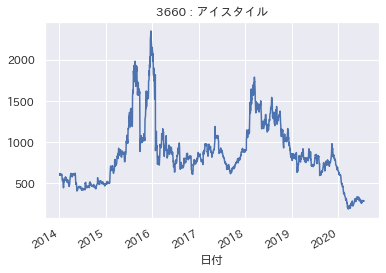

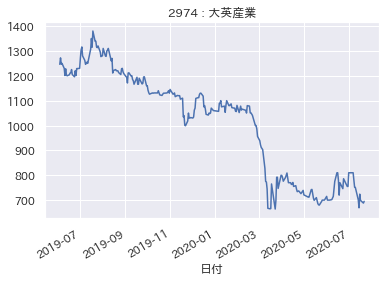

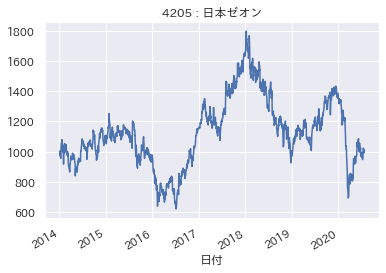

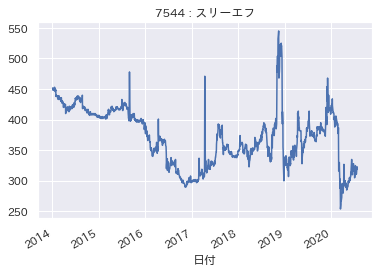

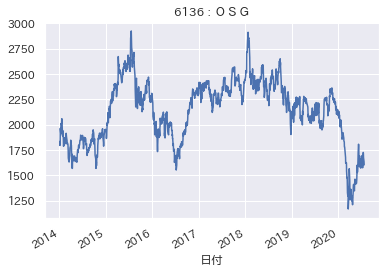

...

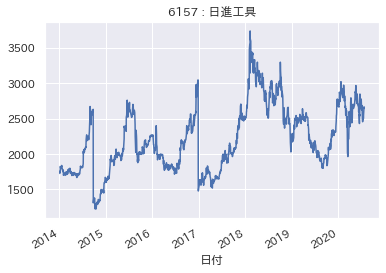

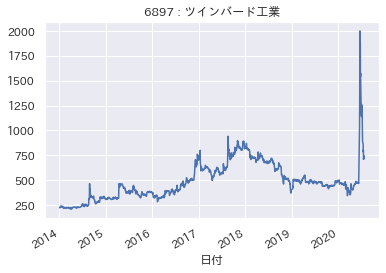

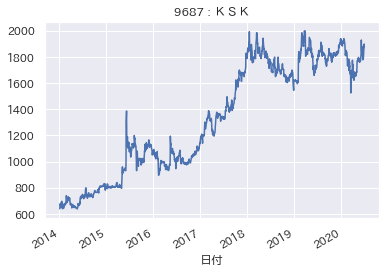

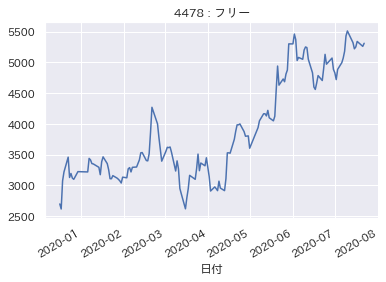

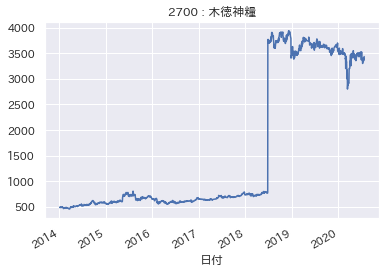

In [16]:
for code, df in df_dict.items():
    df[df.index >= START_DT]['終値'].plot()
    plt.title(f'{code} : {code2company(code)}')
    plt.show()

In [17]:
EXCLUDE_CODES = [2974, 3125, 4478, 2700]

In [18]:
target_codes = list(set(df_dict.keys()) - set(EXCLUDE_CODES))

In [19]:
target_codes

[4994, 7544, 7979, 3660, 4205, 6157, 9551, 6897, 5108, 9687, 6136]

### ニュースデータ取得

In [20]:
import boto3
from boto3.dynamodb.conditions import Key
from typing import List, Dict

In [21]:
_aws_session = boto3.session.Session(
    region_name='ap-northeast-1',
    aws_access_key_id=os.environ["AWS_ACCESS_KEY_ID"],
    aws_secret_access_key=os.environ["AWS_SECRET_ACCESS_KEY"],
)

DYNAMO_DB = _aws_session.resource('dynamodb')

In [23]:
class DynamoDB:

    @staticmethod
    def put_items(
        table_name: str,
        items: List[Dict],
        use_batch_writer: bool = False,
    ) -> List:
        """[summary]
        
        Args:
            table_name (str): [description]
            items (List[Dict]): [description]
        
        Raises:
            e: [description]
        
        Returns:
            List: [description]
        """
        if not isinstance(items, list):
            items = [items]

        responses = []
        try:
            table = DYNAMO_DB.Table(table_name)
        except Exception as e:
            print(f'Failed at DYNAMO_DB.Table(table_name) : {e}')
            raise e

        if use_batch_writer:
            with table.batch_writer() as batch:
                for item in items:
                    try:
                        responses.append(
                            batch.put_item(
                                Item=item,
                            )
                        )
                    except Exception as e:
                        print(f'Failed to put data to DynamoDB. Skipping : {e}')
        else:
            for item in items:
                try:
                    responses.append(
                        table.put_item(
                            TableName=table_name,
                            Item=item,
                        )
                    )
                except Exception as e:
                    print(f'Failed to put data to DynamoDB. Skipping : {e}')

        return responses

    @staticmethod
    def partitionkey_query(
        table_name: str,
        partition_key_name: str,
        partition_key: str,
    ) -> List[Dict]:
        try:
            table = DYNAMO_DB.Table(table_name)
        except Exception as e:
            print(f'Failed at DYNAMO_DB.Table(table_name) : {e}')
            raise e

        try:
            response = table.query(
                KeyConditionExpression=Key(partition_key_name).eq(partition_key)
            )
        except Exception as e:
            print(f'Failed to query : {e}')
            return []

        return response['Items']

In [24]:
dates = pd.date_range('2020-03-01', '2020-08-31')

In [25]:
dates[0].strftime('%Y-%m-%d')

'2020-03-01'

In [26]:
news_dict = {}

for dt in pb(dates):
    res = DynamoDB.partitionkey_query(
        table_name='finapp_google_rss_news',
        partition_key_name='published_date',
        partition_key=dt.strftime('%Y-%m-%d'),
    )
    news_dict[dt.strftime("%Y-%m-%d")] = res
    print(f'{dt.strftime("%Y-%m-%d")} : {len(res)}')

2020-03-01 : 239
2020-03-02 : 263
2020-03-03 : 0
2020-03-04 : 0
2020-03-05 : 73
2020-03-06 : 253
2020-03-07 : 224
2020-03-08 : 248
2020-03-09 : 244
2020-03-10 : 240
2020-03-11 : 245
2020-03-12 : 239
2020-03-13 : 262
2020-03-14 : 239
2020-03-15 : 248
2020-03-16 : 242
2020-03-17 : 237
2020-03-18 : 255
2020-03-19 : 266
2020-03-20 : 250
2020-03-21 : 207
2020-03-22 : 249
2020-03-23 : 246
2020-03-24 : 256
2020-03-25 : 263
2020-03-26 : 246
2020-03-27 : 261
2020-03-28 : 240
2020-03-29 : 240
2020-03-30 : 247
2020-03-31 : 255
2020-04-01 : 251
2020-04-02 : 247
2020-04-03 : 255
2020-04-04 : 256
2020-04-05 : 248
2020-04-06 : 256
2020-04-07 : 248
2020-04-08 : 248
2020-04-09 : 253
2020-04-10 : 265
2020-04-11 : 258
2020-04-12 : 261
2020-04-13 : 252
2020-04-14 : 245
2020-04-15 : 245
2020-04-16 : 253
2020-04-17 : 260
2020-04-18 : 244
2020-04-19 : 260
2020-04-20 : 253
2020-04-21 : 254
2020-04-22 : 243
2020-04-23 : 258
2020-04-24 : 254
2020-04-25 : 245
2020-04-26 : 250
2020-04-27 : 248
2020-04-28 : 257
20

In [30]:
news_dict['2020-03-01'][:3]

[{'guidislink': False,
  'id': 'CBMiNGh0dHBzOi8vamFwYW5lc2UuZW5nYWRnZXQuY29tL2pwLTIwMjAtMDMtMDEtMTAwLmh0bWzSAQA',
  'link': 'https://news.google.com/__i/rss/rd/articles/CBMiNGh0dHBzOi8vamFwYW5lc2UuZW5nYWRnZXQuY29tL2pwLTIwMjAtMDMtMDEtMTAwLmh0bWzSAQA?oc=5',
  'links': [{'href': 'https://news.google.com/__i/rss/rd/articles/CBMiNGh0dHBzOi8vamFwYW5lc2UuZW5nYWRnZXQuY29tL2pwLTIwMjAtMDMtMDEtMTAwLmh0bWzSAQA?oc=5',
    'rel': 'alternate',
    'type': 'text/html'}],
  'published': 'Sun, 01 Mar 2020 23:52:05 GMT',
  'published_date': '2020-03-01',
  'source': {'href': 'https://japanese.engadget.com', 'title': 'Engadget 日本版'},
  'summary': '<a href="https://news.google.com/__i/rss/rd/articles/CBMiNGh0dHBzOi8vamFwYW5lc2UuZW5nYWRnZXQuY29tL2pwLTIwMjAtMDMtMDEtMTAwLmh0bWzSAQA?oc=5" target="_blank">100倍ズームカメラスマホやパカパカスマホを触り放題。掘り出し物を探しに西海岸のサムスン体験ストアを訪問</a>&nbsp;&nbsp;<font color="#6f6f6f">Engadget 日本版</font><strong><a href="https://news.google.com/stories/CAAqOQgKIjNDQklTSURvSmMzUnZjbmt0TXpZd1NoTUtFUWotdHE

In [36]:
import re
from dateutil import parser
from pytz import timezone

reg_obj = re.compile(r"<[^>]*?>")
tag_str = "<p><div>hoge</p></div>"

In [40]:
parser.parse("Sun, 01 Mar 2020 09:52:31 GMT").astimezone(timezone('Asia/Tokyo'))

datetime.datetime(2020, 3, 1, 18, 52, 31, tzinfo=<DstTzInfo 'Asia/Tokyo' JST+9:00:00 STD>)

In [52]:
def news_json2df(news_list):
    summaries = [reg_obj.sub('', r['summary']).replace('&nbsp;', ' ') for r in news_list]
    titles = [reg_obj.sub('', r['title']).replace('&nbsp;', ' ') for r in news_list]
    published_list = [parser.parse(r['published']).astimezone(timezone('Asia/Tokyo')) for r in news_list]
    published_list_gmt = [parser.parse(r['published']) for r in news_list]
    topics = [r['topic'] for r in news_list]
    #published_date_list =  [r['published_date'] for r in news_list]
    published_date_list =  [pub.strftime('%Y-%m-%d') for pub in published_list]
    return pd.DataFrame({
        'published': published_list,
        'published_gmt': published_list_gmt,
        'published_date': published_date_list,
        'title': titles,
        'summary': summaries,
        'topic': topics
    })

In [53]:
news_json2df(news_dict['2020-03-01'])

,published,published_gmt,published_date,title,summary,topic
0,2020-03-02 08:52:05+09:00,2020-03-01 23:52:05+00:00,2020-03-02,100倍ズームカメラスマホやパカパカスマホを触り放題。掘り出し物を探しに西海岸のサムスン体験...,100倍ズームカメラスマホやパカパカスマホを触り放題。掘り出し物を探しに西海岸のサムスン体験...,TECHNOLOGY
1,2020-03-02 08:52:00+09:00,2020-03-01 23:52:00+00:00,2020-03-02,10～12月の全産業設備投資は3.5％減、13期ぶりマイナス - ブルームバーグ,10～12月の全産業設備投資は3.5％減、13期ぶりマイナス ブルームバーグ設備投資、約3...,BUSSINESS
2,2020-03-02 08:52:00+09:00,2020-03-01 23:52:00+00:00,2020-03-02,10～12月全産業設備投資､13期ぶりマイナス-世界経済減速や台風で - ブルームバーグ,10～12月全産業設備投資､13期ぶりマイナス-世界経済減速や台風で ブルームバーグ日本企...,BUSSINESS
3,2020-03-02 06:51:00+09:00,2020-03-01 21:51:00+00:00,2020-03-02,19歳FWビニシウスが“メッシ超え”決勝弾!! R・マドリー、天王山クラシコ制して首位奪還 ...,19歳FWビニシウスが“メッシ超え”決勝弾!! R・マドリー、天王山クラシコ制して首位奪還 ...,SPORTS
4,2020-03-01 11:00:00+09:00,2020-03-01 02:00:00+00:00,2020-03-01,1位のタピオカは「ほぼ専門店」の味!? カルディで見つけた「タピオカミルクティー」飲み比べ ...,1位のタピオカは「ほぼ専門店」の味!? カルディで見つけた「タピオカミルクティー」飲み比べ ...,BUSSINESS
...,...,...,...,...,...,...
234,2020-03-02 05:30:00+09:00,2020-03-01 20:30:00+00:00,2020-03-02,【阪急杯】ダイアトニック 進路妨害で3着に降着…北村友「申し訳ない」 - スポーツニッポン,【阪急杯】ダイアトニック 進路妨害で3着に降着…北村友「申し訳ない」 スポーツニッポン北村...,SPORTS
235,2020-03-01 19:11:00+09:00,2020-03-01 10:11:00+00:00,2020-03-01,【阪急杯】ダイアトニックが3着降着 北村友は15日間の騎乗停止 - スポーツニッポン,【阪急杯】ダイアトニックが3着降着 北村友は15日間の騎乗停止 スポーツニッポンGoogl...,SPORTS
236,2020-03-01 16:07:24+09:00,2020-03-01 07:07:24+00:00,2020-03-01,【阪急杯】ベストアクターが３連勝で重賞初Ｖ 落馬負傷から復帰した浜中が導く（スポーツ報知） ...,【阪急杯】ベストアクターが３連勝で重賞初Ｖ 落馬負傷から復帰した浜中が導く（スポーツ報知） ...,SPORTS
237,2020-03-01 18:50:00+09:00,2020-03-01 09:50:00+00:00,2020-03-01,【阪急杯】北村友一騎手が15日間の騎乗停止 ダイアトニックで2位入線も降着 | 競馬ニュース...,【阪急杯】北村友一騎手が15日間の騎乗停止 ダイアトニックで2位入線も降着 | 競馬ニュース...,SPORTS


In [108]:
dfs = []

for dt, news_list in pb(news_dict.items()):
    if len(news_list) == 0:
        continue
    dfs.append(news_json2df(news_list))

In [109]:
df_news = pd.concat(dfs)

In [110]:
df_news

,published,published_gmt,published_date,title,summary,topic
0,2020-03-02 08:52:05+09:00,2020-03-01 23:52:05+00:00,2020-03-02,100倍ズームカメラスマホやパカパカスマホを触り放題。掘り出し物を探しに西海岸のサムスン体験...,100倍ズームカメラスマホやパカパカスマホを触り放題。掘り出し物を探しに西海岸のサムスン体験...,TECHNOLOGY
1,2020-03-02 08:52:00+09:00,2020-03-01 23:52:00+00:00,2020-03-02,10～12月の全産業設備投資は3.5％減、13期ぶりマイナス - ブルームバーグ,10～12月の全産業設備投資は3.5％減、13期ぶりマイナス ブルームバーグ設備投資、約3...,BUSSINESS
2,2020-03-02 08:52:00+09:00,2020-03-01 23:52:00+00:00,2020-03-02,10～12月全産業設備投資､13期ぶりマイナス-世界経済減速や台風で - ブルームバーグ,10～12月全産業設備投資､13期ぶりマイナス-世界経済減速や台風で ブルームバーグ日本企...,BUSSINESS
3,2020-03-02 06:51:00+09:00,2020-03-01 21:51:00+00:00,2020-03-02,19歳FWビニシウスが“メッシ超え”決勝弾!! R・マドリー、天王山クラシコ制して首位奪還 ...,19歳FWビニシウスが“メッシ超え”決勝弾!! R・マドリー、天王山クラシコ制して首位奪還 ...,SPORTS
4,2020-03-01 11:00:00+09:00,2020-03-01 02:00:00+00:00,2020-03-01,1位のタピオカは「ほぼ専門店」の味!? カルディで見つけた「タピオカミルクティー」飲み比べ ...,1位のタピオカは「ほぼ専門店」の味!? カルディで見つけた「タピオカミルクティー」飲み比べ ...,BUSSINESS
...,...,...,...,...,...,...
245,2020-08-22 10:33:22+09:00,2020-08-22 01:33:22+00:00,2020-08-22,コロナ終息は「2年以内」 WHOテドロス氏が言及 [新型コロナウイルス] - 朝日新聞デジタル,コロナ終息は「2年以内」 WHOテドロス氏が言及 [新型コロナウイルス] 朝日新聞デジタル...,WORLD
246,2020-08-22 10:33:22+09:00,2020-08-22 01:33:22+00:00,2020-08-22,コロナ終息は「2年未満で」 WHOテドロス氏が言及 [新型コロナウイルス] - 朝日新聞デジタル,コロナ終息は「2年未満で」 WHOテドロス氏が言及 [新型コロナウイルス] 朝日新聞デジタ...,WORLD
247,2020-08-22 12:10:00+09:00,2020-08-22 03:10:00+00:00,2020-08-22,サツキは児童虐待？「となりのトトロ」2年ぶりの地上波放送で、疑問の声噴出 - リアルライブ,サツキは児童虐待？「となりのトトロ」2年ぶりの地上波放送で、疑問の声噴出 リアルライブ,ENTERTAINMENT
248,2020-08-22 12:10:00+09:00,2020-08-22 03:10:00+00:00,2020-08-22,サツキは児童虐待？「となりのトトロ」放送で時流を反映した指摘 - livedoor,サツキは児童虐待？「となりのトトロ」放送で時流を反映した指摘 livedoor「となりのト...,ENTERTAINMENT


In [111]:
df_news['summary'].duplicated().value_counts()

False    42124
True       160
Name: summary, dtype: int64

In [112]:
df_news.drop_duplicates(subset='summary', keep='last', inplace=True)

In [113]:
df_news

,published,published_gmt,published_date,title,summary,topic
0,2020-03-02 08:52:05+09:00,2020-03-01 23:52:05+00:00,2020-03-02,100倍ズームカメラスマホやパカパカスマホを触り放題。掘り出し物を探しに西海岸のサムスン体験...,100倍ズームカメラスマホやパカパカスマホを触り放題。掘り出し物を探しに西海岸のサムスン体験...,TECHNOLOGY
1,2020-03-02 08:52:00+09:00,2020-03-01 23:52:00+00:00,2020-03-02,10～12月の全産業設備投資は3.5％減、13期ぶりマイナス - ブルームバーグ,10～12月の全産業設備投資は3.5％減、13期ぶりマイナス ブルームバーグ設備投資、約3...,BUSSINESS
2,2020-03-02 08:52:00+09:00,2020-03-01 23:52:00+00:00,2020-03-02,10～12月全産業設備投資､13期ぶりマイナス-世界経済減速や台風で - ブルームバーグ,10～12月全産業設備投資､13期ぶりマイナス-世界経済減速や台風で ブルームバーグ日本企...,BUSSINESS
3,2020-03-02 06:51:00+09:00,2020-03-01 21:51:00+00:00,2020-03-02,19歳FWビニシウスが“メッシ超え”決勝弾!! R・マドリー、天王山クラシコ制して首位奪還 ...,19歳FWビニシウスが“メッシ超え”決勝弾!! R・マドリー、天王山クラシコ制して首位奪還 ...,SPORTS
4,2020-03-01 11:00:00+09:00,2020-03-01 02:00:00+00:00,2020-03-01,1位のタピオカは「ほぼ専門店」の味!? カルディで見つけた「タピオカミルクティー」飲み比べ ...,1位のタピオカは「ほぼ専門店」の味!? カルディで見つけた「タピオカミルクティー」飲み比べ ...,BUSSINESS
...,...,...,...,...,...,...
245,2020-08-22 10:33:22+09:00,2020-08-22 01:33:22+00:00,2020-08-22,コロナ終息は「2年以内」 WHOテドロス氏が言及 [新型コロナウイルス] - 朝日新聞デジタル,コロナ終息は「2年以内」 WHOテドロス氏が言及 [新型コロナウイルス] 朝日新聞デジタル...,WORLD
246,2020-08-22 10:33:22+09:00,2020-08-22 01:33:22+00:00,2020-08-22,コロナ終息は「2年未満で」 WHOテドロス氏が言及 [新型コロナウイルス] - 朝日新聞デジタル,コロナ終息は「2年未満で」 WHOテドロス氏が言及 [新型コロナウイルス] 朝日新聞デジタ...,WORLD
247,2020-08-22 12:10:00+09:00,2020-08-22 03:10:00+00:00,2020-08-22,サツキは児童虐待？「となりのトトロ」2年ぶりの地上波放送で、疑問の声噴出 - リアルライブ,サツキは児童虐待？「となりのトトロ」2年ぶりの地上波放送で、疑問の声噴出 リアルライブ,ENTERTAINMENT
248,2020-08-22 12:10:00+09:00,2020-08-22 03:10:00+00:00,2020-08-22,サツキは児童虐待？「となりのトトロ」放送で時流を反映した指摘 - livedoor,サツキは児童虐待？「となりのトトロ」放送で時流を反映した指摘 livedoor「となりのト...,ENTERTAINMENT


In [114]:
df_news.to_csv('/content/drive/MyDrive/data/google_news_20200301_20200822.csv', index=False)

In [22]:
df_news = pd.read_csv('/content/drive/MyDrive/data/google_news_20200301_20200822.csv')

In [23]:
df_news['published_date'] = pd.to_datetime(df_news['published_date'])

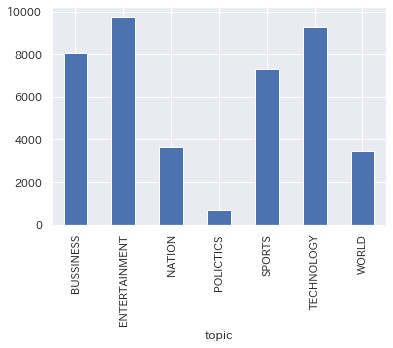

In [24]:
df_news.groupby('topic')['topic'].count().plot.bar()

In [25]:
df_news.sample(10)['summary'].tolist()

['iPhoneに続き、Apple Watch Series 6のバッテリー容量も減少?  iPhone Mania一部のApple Watch Series 5で「電池残量が約50％になるとシャットダウン」 複数報告  Engadget 日本版Apple Watch Series 6には血中酸素センサー搭載だとか  GIZMODO JAPAN増える？減る？ Apple Watch Series 6はバッテリー容量に手がかり  Engadget 日本版Google ニュースですべての記事を見る',
 '【ポケモンGO】「どんぐりポケモンの謎を解け！」タネボーのスペシャルリサーチ解説！  攻略大百科【ポケモンGO】色違いタネボーの出現確率は? 5月コミュニティ・デイを自宅からプレイしてみた  AppBank.netポケモンGO、タネボーの在宅対応コミュニティ・デイ開始。24日17時まで  Engadget日本版家で遊ぶ「ポケモンGO」 24日はタネボーの「コミュニティ・デイ」 YouTubeで初の24時間ライブ配信も  ITmedia【ポケモンGO】公式投票がTwitterで実施中! 来月のコミュニティデイに出るのは誰だ?  AppBankGoogle ニュースですべての記事を見る',
 '「CEDEC 2020」が現地開催を断念、今年はオンライン開催に変更へ。新型コロナウイルスの影響により（2020年5月8日）｜BIGLOBEニュース  BIGLOBEニュース開発者会議・CEDEC 2020はオンラインでの開催に変更。9月2日〜4日の会期に変更なし  4Gamer.net「CEDEC 2020」、オンライン開催に変更し9月2日より開催  GAME Watchゲーム開発者向けイベントCEDEC 2020はオンラインにて開催へ。開催期間は9月2日から4日、詳細は決定次第発表  AUTOMATONCEDEC 2020はオンライン開催に決定  GamesIndustry.biz Japan EditionGoogle ニュースですべての記事を見る',
 '「ドラクエウォーク」のおみやげが商品化！ 「リアルおみやげプロジェクト」始動  GAME Watch「ドラゴンクエストウォーク」でリアルおみやげプロジェクトが7月23日に始動。第1弾としてスライムかまぼこを期間限定販売  

### ターゲットデータ作成

In [26]:
target_codes

[4994, 7544, 7979, 3660, 4205, 6157, 9551, 6897, 5108, 9687, 6136]

In [27]:
df_dict[4994]

,始値,高値,安値,終値,出来高,終値調整値,last_close,stop_high_low
日付,,,,,,,,
2002-04-12,3200,3460,3200,3410,2964100,3410,NaN,0
2002-04-15,3300,3440,3250,3350,504500,3350,3410.0,0
2002-04-16,3320,3420,3120,3410,331900,3410,3350.0,0
2002-04-17,3510,3670,3440,3620,613500,3620,3410.0,0
2002-04-18,3670,3800,3570,3770,411800,3770,3620.0,0
...,...,...,...,...,...,...,...,...
2020-07-15,2832,2832,2735,2830,6300,2830,2789.0,0
2020-07-16,2830,2830,2790,2790,1400,2790,2830.0,0
2020-07-17,2791,2791,2784,2790,800,2790,2790.0,0


In [28]:
import numpy as np

In [29]:
def pct_change2label(pct_change, thresh):
    if np.isnan(pct_change):
        return pct_change
    elif pct_change < -thresh:  # down
        return 0
    elif pct_change <= thresh:  # no change
        return 1
    else:  # up
        return 2

In [30]:
df_dict[4994]['終値'].pct_change(2)

日付
2002-04-12         NaN
2002-04-15         NaN
2002-04-16    0.000000
2002-04-17    0.080597
2002-04-18    0.105572
                ...   
2020-07-15    0.072782
2020-07-16    0.000359
2020-07-17   -0.014134
2020-07-21    0.008961
2020-07-22   -0.005376
Name: 終値, Length: 4473, dtype: float64

In [31]:
import functools

In [32]:
df_dict[4994]['終値'].pct_change(2).quantile(0.66)

0.005043312390416473

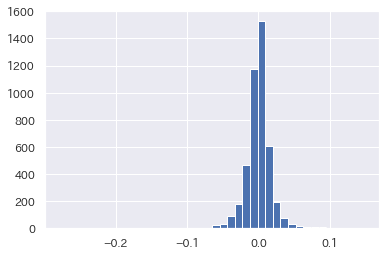

In [33]:
df_dict[4994]['終値'].pct_change(2).hist(bins=40)

In [34]:
thresh = df_dict[4994]['終値'].pct_change(2).quantile(0.66)
labels = df_dict[4994]['終値'].pct_change(2).map(functools.partial(pct_change2label, thresh=thresh))
labels

日付
2002-04-12    NaN
2002-04-15    NaN
2002-04-16    1.0
2002-04-17    2.0
2002-04-18    2.0
             ... 
2020-07-15    2.0
2020-07-16    1.0
2020-07-17    0.0
2020-07-21    2.0
2020-07-22    0.0
Name: 終値, Length: 4473, dtype: float64

In [35]:
labels.value_counts()

1.0    1532
2.0    1520
0.0    1419
Name: 終値, dtype: int64

In [36]:
def join_target_to_news(
    df_news,
    df_stockprice,
    code,
    day_lags=[1, 3, 7, 14]
):
    df_news_copy = df_news.copy()
    for lag in day_lags:
        thresh = df_stockprice['終値'].pct_change(lag).quantile(0.66)
        df_news_copy = pd.merge(
            df_news_copy,
            df_stockprice['終値'].pct_change(lag).shift(-lag).map(functools.partial(pct_change2label, thresh=thresh)).to_frame(f'{code}_dlag{lag}'),
            how='left',
            left_on='published_date',
            right_index=True
        )
    return df_news_copy

In [37]:
tmp = join_target_to_news(
    df_news, df_dict[4994], 4994
)

In [38]:
tmp

,published,published_gmt,published_date,title,summary,topic,4994_dlag1,4994_dlag3,4994_dlag7,4994_dlag14
0,2020-03-02 08:52:05+09:00,2020-03-01 23:52:05+00:00,2020-03-02,100倍ズームカメラスマホやパカパカスマホを触り放題。掘り出し物を探しに西海岸のサムスン体験...,100倍ズームカメラスマホやパカパカスマホを触り放題。掘り出し物を探しに西海岸のサムスン体験...,TECHNOLOGY,0.0,0.0,0.0,0.0
1,2020-03-02 08:52:00+09:00,2020-03-01 23:52:00+00:00,2020-03-02,10～12月の全産業設備投資は3.5％減、13期ぶりマイナス - ブルームバーグ,10～12月の全産業設備投資は3.5％減、13期ぶりマイナス ブルームバーグ設備投資、約3...,BUSSINESS,0.0,0.0,0.0,0.0
2,2020-03-02 08:52:00+09:00,2020-03-01 23:52:00+00:00,2020-03-02,10～12月全産業設備投資､13期ぶりマイナス-世界経済減速や台風で - ブルームバーグ,10～12月全産業設備投資､13期ぶりマイナス-世界経済減速や台風で ブルームバーグ日本企...,BUSSINESS,0.0,0.0,0.0,0.0
3,2020-03-02 06:51:00+09:00,2020-03-01 21:51:00+00:00,2020-03-02,19歳FWビニシウスが“メッシ超え”決勝弾!! R・マドリー、天王山クラシコ制して首位奪還 ...,19歳FWビニシウスが“メッシ超え”決勝弾!! R・マドリー、天王山クラシコ制して首位奪還 ...,SPORTS,0.0,0.0,0.0,0.0
4,2020-03-01 11:00:00+09:00,2020-03-01 02:00:00+00:00,2020-03-01,1位のタピオカは「ほぼ専門店」の味!? カルディで見つけた「タピオカミルクティー」飲み比べ ...,1位のタピオカは「ほぼ専門店」の味!? カルディで見つけた「タピオカミルクティー」飲み比べ ...,BUSSINESS,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
42119,2020-08-22 10:33:22+09:00,2020-08-22 01:33:22+00:00,2020-08-22,コロナ終息は「2年以内」 WHOテドロス氏が言及 [新型コロナウイルス] - 朝日新聞デジタル,コロナ終息は「2年以内」 WHOテドロス氏が言及 [新型コロナウイルス] 朝日新聞デジタル...,WORLD,NaN,NaN,NaN,NaN
42120,2020-08-22 10:33:22+09:00,2020-08-22 01:33:22+00:00,2020-08-22,コロナ終息は「2年未満で」 WHOテドロス氏が言及 [新型コロナウイルス] - 朝日新聞デジタル,コロナ終息は「2年未満で」 WHOテドロス氏が言及 [新型コロナウイルス] 朝日新聞デジタ...,WORLD,NaN,NaN,NaN,NaN
42121,2020-08-22 12:10:00+09:00,2020-08-22 03:10:00+00:00,2020-08-22,サツキは児童虐待？「となりのトトロ」2年ぶりの地上波放送で、疑問の声噴出 - リアルライブ,サツキは児童虐待？「となりのトトロ」2年ぶりの地上波放送で、疑問の声噴出 リアルライブ,ENTERTAINMENT,NaN,NaN,NaN,NaN
42122,2020-08-22 12:10:00+09:00,2020-08-22 03:10:00+00:00,2020-08-22,サツキは児童虐待？「となりのトトロ」放送で時流を反映した指摘 - livedoor,サツキは児童虐待？「となりのトトロ」放送で時流を反映した指摘 livedoor「となりのト...,ENTERTAINMENT,NaN,NaN,NaN,NaN


In [39]:
df_news_target = df_news.copy()

for code in target_codes:
    df_news_target = join_target_to_news(
        df_news_target, df_dict[code], code
    )

In [40]:
df_news_target

,published,published_gmt,published_date,title,summary,topic,4994_dlag1,4994_dlag3,4994_dlag7,4994_dlag14,7544_dlag1,7544_dlag3,7544_dlag7,7544_dlag14,7979_dlag1,7979_dlag3,7979_dlag7,7979_dlag14,3660_dlag1,3660_dlag3,3660_dlag7,3660_dlag14,4205_dlag1,4205_dlag3,4205_dlag7,4205_dlag14,6157_dlag1,6157_dlag3,6157_dlag7,6157_dlag14,9551_dlag1,9551_dlag3,9551_dlag7,9551_dlag14,6897_dlag1,6897_dlag3,6897_dlag7,6897_dlag14,5108_dlag1,5108_dlag3,5108_dlag7,5108_dlag14,9687_dlag1,9687_dlag3,9687_dlag7,9687_dlag14,6136_dlag1,6136_dlag3,6136_dlag7,6136_dlag14
0,2020-03-02 08:52:05+09:00,2020-03-01 23:52:05+00:00,2020-03-02,100倍ズームカメラスマホやパカパカスマホを触り放題。掘り出し物を探しに西海岸のサムスン体験...,100倍ズームカメラスマホやパカパカスマホを触り放題。掘り出し物を探しに西海岸のサムスン体験...,TECHNOLOGY,0.0,0.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,1.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
1,2020-03-02 08:52:00+09:00,2020-03-01 23:52:00+00:00,2020-03-02,10～12月の全産業設備投資は3.5％減、13期ぶりマイナス - ブルームバーグ,10～12月の全産業設備投資は3.5％減、13期ぶりマイナス ブルームバーグ設備投資、約3...,BUSSINESS,0.0,0.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,1.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
2,2020-03-02 08:52:00+09:00,2020-03-01 23:52:00+00:00,2020-03-02,10～12月全産業設備投資､13期ぶりマイナス-世界経済減速や台風で - ブルームバーグ,10～12月全産業設備投資､13期ぶりマイナス-世界経済減速や台風で ブルームバーグ日本企...,BUSSINESS,0.0,0.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,1.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
3,2020-03-02 06:51:00+09:00,2020-03-01 21:51:00+00:00,2020-03-02,19歳FWビニシウスが“メッシ超え”決勝弾!! R・マドリー、天王山クラシコ制して首位奪還 ...,19歳FWビニシウスが“メッシ超え”決勝弾!! R・マドリー、天王山クラシコ制して首位奪還 ...,SPORTS,0.0,0.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,1.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
4,2020-03-01 11:00:00+09:00,2020-03-01 02:00:00+00:00,2020-03-01,1位のタピオカは「ほぼ専門店」の味!? カルディで見つけた「タピオカミルクティー」飲み比べ ...,1位のタピオカは「ほぼ専門店」の味!? カルディで見つけた「タピオカミルクティー」飲み比べ ...,BUSSINESS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42119,2020-08-22 10:33:22+09:00,2020-08-22 01:33:22+00:00,2020-08-22,コロナ終息は「2年以内」 WHOテドロス氏が言及 [新型コロナウイルス] - 朝日新聞デジタル,コロナ終息は「2年以内」 WHOテドロス氏が言及 [新型コロナウイルス] 朝日新聞デジタル...,WORLD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
42120,2020-08-22 10:33:22+09:00,2020-08-22 01:33:22+00:00,2020-08-22,コロナ終息は「2年未満で」 WHOテドロス氏が言及 [新型コロナウイルス] - 朝日新聞デジタル,コロナ終息は「2年未満で」 WHOテドロス氏が言及 [新型コロナウイルス] 朝日新聞デジタ...,WORLD,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
42121,2020-08-22 12:10:00+09:00,2020-08-22 03:10:00+00:00,2020-08-22,サツキは児童虐待？「となりのトトロ」2年ぶりの地上波放送で、疑問の声噴出 - リアルライブ,サツキは児童虐待？「となりのトトロ」2年ぶりの地上波放送で、疑問の声噴出 リアルライブ,ENTERTAINMENT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
42122,2020-08-22 12:10:00+09:00,2020-08-22 03:10:00+00:00,2020-08-22,サツキは児童虐待？「となりのトトロ」放送で時流を反映した指摘 - livedoor,サツキは児童虐待？「となりのトトロ」放送で時流を反映した指摘 livedoor「となりのト...,ENTERTAINMENT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [41]:
df_news_target[df_news_target['3660_dlag1'].isna()]['published_date'].unique()

array(['2020-03-01T00:00:00.000000000', '2020-03-07T00:00:00.000000000',
       '2020-03-08T00:00:00.000000000', '2020-03-14T00:00:00.000000000',
       '2020-03-15T00:00:00.000000000', '2020-03-20T00:00:00.000000000',
       '2020-03-21T00:00:00.000000000', '2020-03-22T00:00:00.000000000',
       '2020-03-28T00:00:00.000000000', '2020-03-29T00:00:00.000000000',
       '2020-04-04T00:00:00.000000000', '2020-04-05T00:00:00.000000000',
       '2020-04-11T00:00:00.000000000', '2020-04-12T00:00:00.000000000',
       '2020-04-18T00:00:00.000000000', '2020-04-19T00:00:00.000000000',
       '2020-04-25T00:00:00.000000000', '2020-04-26T00:00:00.000000000',
       '2020-04-29T00:00:00.000000000', '2020-05-02T00:00:00.000000000',
       '2020-05-03T00:00:00.000000000', '2020-05-04T00:00:00.000000000',
       '2020-05-05T00:00:00.000000000', '2020-05-06T00:00:00.000000000',
       '2020-05-09T00:00:00.000000000', '2020-05-10T00:00:00.000000000',
       '2020-05-16T00:00:00.000000000', '2020-05-17

-> 休日祝日

In [42]:
len(df_news_target[~df_news_target['3660_dlag1'].isna()])

22519

### ニューステキスト処理

In [52]:
!rm -rf './mecab-ipadic-neologd'

In [53]:
!apt-get -q -y install sudo file mecab libmecab-dev mecab-ipadic-utf8 git curl python-mecab > /dev/null
!git clone --depth 1 https://github.com/neologd/mecab-ipadic-neologd.git > /dev/null 
!echo yes | mecab-ipadic-neologd/bin/install-mecab-ipadic-neologd -n > /dev/null 2>&1
!pip install mecab-python3 > /dev/null

!ln -s /etc/mecabrc /usr/local/etc/mecabrc

Cloning into 'mecab-ipadic-neologd'...
remote: Enumerating objects: 75, done.
remote: Counting objects: 100% (75/75), done.
remote: Compressing objects: 100% (74/74), done.
remote: Total 75 (delta 5), reused 54 (delta 0), pack-reused 0
Unpacking objects: 100% (75/75), done.
ln: failed to create symbolic link '/usr/local/etc/mecabrc': File exists


In [54]:
df_news.sample(30)['summary'].tolist()

['IOCバッハ会長「数百億円」五輪延期費用負担 総額3千億円規模…再延期には否定的（スポニチアネックス）  Yahoo!ニュース東京五輪 ＩＯＣ追加負担、「数百億円」想定 バッハ会長  毎日新聞8兆円超の損失！五輪開催を頑なに曲げなかった日本の葛藤―中国メディア  Record ChinaIOC追加負担は数百億円 22年延期「日本側が難色」―バッハ会長（時事通信）  Yahoo!ニュースバッハ会長「ＩＯＣは数百億円の追加負担」…中止の保険かけたが、延期は対象外  auone.jpGoogle ニュースですべての記事を見る',
 '『愛の不時着』カップル参加!『梨泰院クラス』からも!! 百想芸術大賞の受賞者たち｜スポーツソウル日本版  スポーツソウル日本版コン・ヒョジン、ドラマ｢椿の花咲く頃｣ファミリーと再会…｢百想芸術大賞｣で大賞受賞  WOW! Korea新型コロナに負けず輝いた「スターたちの祭典」＝百想芸術大賞（朝鮮日報日本語版）  Yahoo!ニュース「愛の不時着」や「梨泰院クラス」のキャストが集結! 第56回百想芸術大賞に来場した韓国スターたち。  VOGUE JAPANキム・ヒエ、ドラマ｢夫婦の世界｣で｢百想芸術大賞｣最優秀演技賞受賞｢苦労した方々と分かち合いたい｣  WOW! KoreaGoogle ニュースですべての記事を見る',
 'BTS、新曲「Stay Gold」が田中圭主演『らせんの迷宮』主題歌に  BARKSBTS、田中圭ゴールデン初主演ドラマの主題歌に「僕たちの歌を楽しみながら、ドラマも楽しんでいただければ」 | Daily News  Billboard JAPAN防弾少年団、日本ドラマ『らせんの迷宮』で主題歌担当（中央日報日本語版）  Yahoo!ニュースBTSコメントあり！主題歌は、グローバルスーパースターBTSの 最新曲「Stay Gold」に決定：...｜テレ東プラス  テレビ東京BTS、「Stay Gold」が田中圭主演ドラマ『らせんの迷宮～DNA科学捜査～』主題歌に 今夏発売日本版アルバムに収録  Real SoundGoogle ニュースですべての記事を見る',
 '“全英”とれて「AIG女子オープン」に 渋野優勝の海外メジャー  ゴルフダイジェスト・オンライン',
 '1000人分の病院用ベッドも…世界最大級の病院船、

In [55]:
import MeCab

m = MeCab.Tagger('-Ochasen -d /usr/lib/x86_64-linux-gnu/mecab/dic/mecab-ipadic-neologd')
sample_txt = 'Official髭男dism メンバーが語る出会いから結成まで（ロング版インタビュー）  読売新聞Official髭男dismが初出演「SONGS」で今届けたい曲披露、メンバーの希望で亀田誠治と対談  ナタリーOfficial髭男dism、NHK『SONGS』初出演 亀田誠治との対談で歌詞や音楽性の秘密が明らかに（リアルサウンド）  Yahoo!ニュースOfficial髭男dism『SONGS』に登場、亀田誠治との対談やスタジオライブ | Daily News  Billboard JAPANOfficial髭男dism：NHK「SONGS」初登場 亀田誠治と対談、ファンの声から魅力ひもとく  MANTANWEBGoogle ニュースですべての記事を見る'
print(m.parse(sample_txt))

Official髭男dism	オフィシャルヒゲダンディズム	Official髭男dism	名詞-固有名詞-人名-一般		
メンバー	メンバー	メンバー	名詞-一般		
が	ガ	が	助詞-格助詞-一般		
語る	カタル	語る	動詞-自立	五段・ラ行	基本形
出会い	デアイ	出会い	名詞-一般		
から	カラ	から	助詞-格助詞-一般		
結成	ケッセイ	結成	名詞-サ変接続		
まで	マデ	まで	助詞-副助詞		
（	（	（	記号-括弧開		
ロング	ロング	ロング	名詞-一般		
版	バン	版	名詞-接尾-一般		
インタビュー	インタビュー	インタビュー	名詞-サ変接続		
）	）	）	記号-括弧閉		
読売新聞	ヨミウリシンブン	読売新聞	名詞-固有名詞-組織		
Official髭男dism	オフィシャルヒゲダンディズム	Official髭男dism	名詞-固有名詞-人名-一般		
が	ガ	が	助詞-格助詞-一般		
初出演	ハツシュツエン	初出演	名詞-固有名詞-一般		
「	「	「	記号-括弧開		
SONGS	サンオノフレゲンパツ	SONGS	名詞-固有名詞-一般		
」	」	」	記号-括弧閉		
で	デ	で	助詞-格助詞-一般		
今	イマ	今	名詞-副詞可能		
届け	トドケ	届ける	動詞-自立	一段	連用形
た	タ	た	助動詞	特殊・タ	基本形
い曲	イキョク	委曲	名詞-一般		
披露	ヒロウ	披露	名詞-サ変接続		
、	、	、	記号-読点		
メンバー	メンバー	メンバー	名詞-一般		
の	ノ	の	助詞-連体化		
希望	キボウ	希望	名詞-サ変接続		
で	デ	で	助詞-格助詞-一般		
亀田誠治	カメダセイジ	亀田誠治	名詞-固有名詞-人名-一般		
と	ト	と	助詞-格助詞-引用		
対談	タイダン	対談	名詞-サ変接続		
ナタリー	ナタリー	ナタリー	名詞-固有名詞-人名-名		
Official髭男dism	オフィシャルヒゲダンディズム	Official髭男dism	名詞-固有名詞-人名-一般		
、	、	、	記号-読点		
NHK	エヌエイチケイ	NHK	名詞-固有名詞-一般		
『	『	『	記号-括弧開		
SONGS	サンオノフレゲンパツ	SONGS	名詞-固有名詞-一般		
』	』	』	記号-括弧閉		
初出演	ハツシュ

In [56]:
import MeCab

m_wakati = MeCab.Tagger('-Owakati -d /usr/lib/x86_64-linux-gnu/mecab/dic/mecab-ipadic-neologd')
sample_txt = 'Official髭男dism メンバーが語る出会いから結成まで（ロング版インタビュー）  読売新聞Official髭男dismが初出演「SONGS」で今届けたい曲披露、メンバーの希望で亀田誠治と対談  ナタリーOfficial髭男dism、NHK『SONGS』初出演 亀田誠治との対談で歌詞や音楽性の秘密が明らかに（リアルサウンド）  Yahoo!ニュースOfficial髭男dism『SONGS』に登場、亀田誠治との対談やスタジオライブ | Daily News  Billboard JAPANOfficial髭男dism：NHK「SONGS」初登場 亀田誠治と対談、ファンの声から魅力ひもとく  MANTANWEBGoogle ニュースですべての記事を見る'
print(m.parse(sample_txt))

Official髭男dism	オフィシャルヒゲダンディズム	Official髭男dism	名詞-固有名詞-人名-一般		
メンバー	メンバー	メンバー	名詞-一般		
が	ガ	が	助詞-格助詞-一般		
語る	カタル	語る	動詞-自立	五段・ラ行	基本形
出会い	デアイ	出会い	名詞-一般		
から	カラ	から	助詞-格助詞-一般		
結成	ケッセイ	結成	名詞-サ変接続		
まで	マデ	まで	助詞-副助詞		
（	（	（	記号-括弧開		
ロング	ロング	ロング	名詞-一般		
版	バン	版	名詞-接尾-一般		
インタビュー	インタビュー	インタビュー	名詞-サ変接続		
）	）	）	記号-括弧閉		
読売新聞	ヨミウリシンブン	読売新聞	名詞-固有名詞-組織		
Official髭男dism	オフィシャルヒゲダンディズム	Official髭男dism	名詞-固有名詞-人名-一般		
が	ガ	が	助詞-格助詞-一般		
初出演	ハツシュツエン	初出演	名詞-固有名詞-一般		
「	「	「	記号-括弧開		
SONGS	サンオノフレゲンパツ	SONGS	名詞-固有名詞-一般		
」	」	」	記号-括弧閉		
で	デ	で	助詞-格助詞-一般		
今	イマ	今	名詞-副詞可能		
届け	トドケ	届ける	動詞-自立	一段	連用形
た	タ	た	助動詞	特殊・タ	基本形
い曲	イキョク	委曲	名詞-一般		
披露	ヒロウ	披露	名詞-サ変接続		
、	、	、	記号-読点		
メンバー	メンバー	メンバー	名詞-一般		
の	ノ	の	助詞-連体化		
希望	キボウ	希望	名詞-サ変接続		
で	デ	で	助詞-格助詞-一般		
亀田誠治	カメダセイジ	亀田誠治	名詞-固有名詞-人名-一般		
と	ト	と	助詞-格助詞-引用		
対談	タイダン	対談	名詞-サ変接続		
ナタリー	ナタリー	ナタリー	名詞-固有名詞-人名-名		
Official髭男dism	オフィシャルヒゲダンディズム	Official髭男dism	名詞-固有名詞-人名-一般		
、	、	、	記号-読点		
NHK	エヌエイチケイ	NHK	名詞-固有名詞-一般		
『	『	『	記号-括弧開		
SONGS	サンオノフレゲンパツ	SONGS	名詞-固有名詞-一般		
』	』	』	記号-括弧閉		
初出演	ハツシュ

In [57]:
STOP_WORDS_SENTENCES = [
    'Google ニュースですべての記事を見る',
    'Yahoo!ニュース',
    'BIGLOBEニュース',
    '4Gamer.net',
    'livedoor'
]

In [58]:
import string
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [59]:
def preprocess(text):
    for ss in STOP_WORDS_SENTENCES:
        text = text.replace(ss, '')
    
    for p in string.punctuation:
        text = text.replace(p, '')
    
    parsed = m_wakati.parse(text)
    tokens = parsed.strip().split()
    return tokens

In [60]:
preprocess('「サザエさん」アフレコがコロナ禍で中止 サザエ役の加藤みどり「誰か1人でも出たとなったら…」  auone.jpサザエさんのアフレコが無期限中止に 声優の加藤みどりが明かす  livedoor【新型コロナウイルス】『サザエさん』アフレコが無期限中止 加藤みどりが明かす  ニフティニュース「サザエさん」アフレコがコロナ禍で中止 サザエ役の加藤みどり「誰か1人でも出たとなったら…」（スポニチアネックス）  Yahoo!ニュース「サザエさん」アフレコがコロナ禍で中止 サザエ役の加藤みどり「誰か1人でも出たとなったら…」（2020年4月4日）｜BIGLOBEニュース  BIGLOBEニュースGoogle ニュースですべての記事を見る')

['「',
 'サザエさん',
 '」',
 'アフレコ',
 'が',
 'コロナ禍',
 'で',
 '中止',
 'サザエ',
 '役',
 'の',
 '加藤みどり',
 '「',
 '誰か',
 '1人',
 'で',
 'も',
 '出',
 'た',
 'と',
 'なっ',
 'たら',
 '…',
 '」',
 'auonejp',
 'サザエさん',
 'の',
 'アフレコ',
 'が',
 '無期限',
 '中止',
 'に',
 '声優',
 'の',
 '加藤みどり',
 'が',
 '明かす',
 '【',
 '新型コロナウイルス',
 '】',
 '『',
 'サザエさん',
 '』',
 'アフレコ',
 'が',
 '無期限',
 '中止',
 '加藤みどり',
 'が',
 '明かす',
 'ニフティ',
 'ニュース',
 '「',
 'サザエさん',
 '」',
 'アフレコ',
 'が',
 'コロナ禍',
 'で',
 '中止',
 'サザエ',
 '役',
 'の',
 '加藤みどり',
 '「',
 '誰か',
 '1人',
 'で',
 'も',
 '出',
 'た',
 'と',
 'なっ',
 'たら',
 '…',
 '」',
 '（',
 'スポニチアネックス',
 '）',
 '「',
 'サザエさん',
 '」',
 'アフレコ',
 'が',
 'コロナ禍',
 'で',
 '中止',
 'サザエ',
 '役',
 'の',
 '加藤みどり',
 '「',
 '誰か',
 '1人',
 'で',
 'も',
 '出',
 'た',
 'と',
 'なっ',
 'たら',
 '…',
 '」',
 '（',
 '2020年',
 '4月4日',
 '）',
 '｜']

### メタウォーターの1日後のリターン予測でテスト

In [61]:
df_news_target['summary'].map(lambda x: len(preprocess(x))).max()

220

In [62]:
max_len = 221

In [63]:
import torchtext

In [64]:
TEXT = torchtext.data.Field(
    sequential=True,
    tokenize=preprocess,
    use_vocab=True,
    lower=True,
    include_lengths=True,
    batch_first=True,
    fix_length=max_len,
    init_token='<cls>',
    eos_token='<eos>'
)

In [65]:
LABEL = torchtext.data.Field(
    sequential=False,
    use_vocab=False
)

In [66]:
target_col = '9551_dlag1'

In [67]:
from sklearn.model_selection import train_test_split

In [68]:
# 一旦休日祝日分のニュースは除外
df_news_target_9551 = df_news_target.dropna(subset=['9551_dlag1'])

In [69]:
df_news_target_9551[target_col] = df_news_target_9551[target_col].astype(int)

In [70]:
df_news_target_9551

,published,published_gmt,published_date,title,summary,topic,4994_dlag1,4994_dlag3,4994_dlag7,4994_dlag14,7544_dlag1,7544_dlag3,7544_dlag7,7544_dlag14,7979_dlag1,7979_dlag3,7979_dlag7,7979_dlag14,3660_dlag1,3660_dlag3,3660_dlag7,3660_dlag14,4205_dlag1,4205_dlag3,4205_dlag7,4205_dlag14,6157_dlag1,6157_dlag3,6157_dlag7,6157_dlag14,9551_dlag1,9551_dlag3,9551_dlag7,9551_dlag14,6897_dlag1,6897_dlag3,6897_dlag7,6897_dlag14,5108_dlag1,5108_dlag3,5108_dlag7,5108_dlag14,9687_dlag1,9687_dlag3,9687_dlag7,9687_dlag14,6136_dlag1,6136_dlag3,6136_dlag7,6136_dlag14
0,2020-03-02 08:52:05+09:00,2020-03-01 23:52:05+00:00,2020-03-02,100倍ズームカメラスマホやパカパカスマホを触り放題。掘り出し物を探しに西海岸のサムスン体験...,100倍ズームカメラスマホやパカパカスマホを触り放題。掘り出し物を探しに西海岸のサムスン体験...,TECHNOLOGY,0.0,0.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2,1.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
1,2020-03-02 08:52:00+09:00,2020-03-01 23:52:00+00:00,2020-03-02,10～12月の全産業設備投資は3.5％減、13期ぶりマイナス - ブルームバーグ,10～12月の全産業設備投資は3.5％減、13期ぶりマイナス ブルームバーグ設備投資、約3...,BUSSINESS,0.0,0.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2,1.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
2,2020-03-02 08:52:00+09:00,2020-03-01 23:52:00+00:00,2020-03-02,10～12月全産業設備投資､13期ぶりマイナス-世界経済減速や台風で - ブルームバーグ,10～12月全産業設備投資､13期ぶりマイナス-世界経済減速や台風で ブルームバーグ日本企...,BUSSINESS,0.0,0.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2,1.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
3,2020-03-02 06:51:00+09:00,2020-03-01 21:51:00+00:00,2020-03-02,19歳FWビニシウスが“メッシ超え”決勝弾!! R・マドリー、天王山クラシコ制して首位奪還 ...,19歳FWビニシウスが“メッシ超え”決勝弾!! R・マドリー、天王山クラシコ制して首位奪還 ...,SPORTS,0.0,0.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2,1.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
5,2020-03-02 08:40:00+09:00,2020-03-01 23:40:00+00:00,2020-03-02,1才の男の子を優しく見守る白猫の姿が660万再生「ジブリの世界」「最高のシッター」 - au...,1才の男の子を優しく見守る白猫の姿が660万再生「ジブリの世界」「最高のシッター」 auo...,ENTERTAINMENT,0.0,0.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2,1.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27246,2020-06-24 16:02:54+09:00,2020-06-24 07:02:54+00:00,2020-06-24,「今でも妻を愛しています」渡部建が独占告白（文春オンライン） - yahoo.co.jp,「今でも妻を愛しています」渡部建が独占告白（文春オンライン） yahoo.co.jpGoo...,ENTERTAINMENT,1.0,2.0,2.0,2.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,2.0,2.0,1.0,0.0,0,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,NaN,NaN,NaN,0.0,2.0,2.0,2.0
27247,2020-06-24 11:51:30+09:00,2020-06-24 02:51:30+00:00,2020-06-24,「俺たちのばっしー」がやってくれた！石橋伸洋、自身最終戦で快勝／麻雀・Mリーグ | ABEM...,「俺たちのばっしー」がやってくれた！石橋伸洋、自身最終戦で快勝／麻雀・Mリーグ | ABEM...,ENTERTAINMENT,1.0,2.0,2.0,2.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,2.0,2.0,1.0,0.0,0,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,NaN,NaN,NaN,0.0,2.0,2.0,2.0
27248,2020-06-24 18:13:24+09:00,2020-06-24 09:13:24+00:00,2020-06-24,「全員陰性」と虚偽広告 新型コロナ、性風俗店経営者ら逮捕―大阪府警 - 時事通信ニュース,「全員陰性」と虚偽広告 新型コロナ、性風俗店経営者ら逮捕―大阪府警 時事通信ニュースGoo...,NATION,1.0,2.0,2.0,2.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,2.0,2.0,1.0,0.0,0,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,NaN,NaN,NaN,0.0,2.0,2.0,2.0
27249,2020-06-24 20:14:43+09:00,2020-06-24 11:14:43+00:00,2020-06-24,「全従業員の陰性確認」ウソ宣伝の風俗摘発 嬢抗議 - 社会 - ニッカンスポーツ,「全従業員の陰性確認」ウソ宣伝の風俗摘発 嬢抗議 - 社会 ニッカンスポーツ「従業員全員陰...,NATION,1.0,2.0,2.0,2.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,2.0,2.0,1.0,0.0,0,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,NaN,NaN,NaN,0.0,2.0,2.0,2.0


In [71]:
df_train, df_test = train_test_split(df_news_target_9551, test_size=0.2, stratify=df_news_target_9551[target_col] ,random_state=42)

In [72]:
df_train[['summary', target_col]]

,summary,9551_dlag1
26692,iOS 14の対象機種はiPhone 6s以降、初代iPhone SEも生き残る ITme...,1
3634,WHO事務局長が韓国の新型コロナ対応を称賛「降伏しなかった」 livedoorGoogle...,0
21954,17歳MFエリオット、リヴァプール加入前にラモスとの面会を拒否…CL決勝でのファウルで S...,2
5366,“新型コロナ”小千谷市の５０代女性が感染（新潟県）（TeNYテレビ新潟） Yahoo!ニュ...,2
14542,20歳タイソン、衝撃“ワンパンKO”をリング誌復刻 戦慄の左に反響「歴史的な試合」（THE ...,1
...,...,...
11908,「ONE PIECE」が当面、再放送に 26日から 公式サイトが発表（毎日新聞） Yaho...,2
3220,「本当にキレイ…」「素晴らしい腹筋」美人柔道家ビロディドが海をバックに“肉体美ショット”を披...,2
5127,「GAFAへの対抗になる」「対抗はウエルカム」 トヨタとNTTの“連合”、豊田社長と澤田社長...,2
3429,”ナイル川クルーズ”が感染源か 京都・右京区役所勤務の６０代女性が新型コロナウイルス感染（関...,2


In [73]:
df_train[['summary', target_col]].to_csv('./train_9551_lag1d.csv', header=False, index=False)

In [74]:
df_test[['summary', target_col]].to_csv('./test_9551_lag1d.csv', header=False, index=False)

In [75]:
train_ds, test_ds = torchtext.data.TabularDataset.splits(
    path='.',
    train='train_9551_lag1d.csv',
    test='test_9551_lag1d.csv',
    format='csv',
    fields=[('text', TEXT), ('label', LABEL)]
)

In [76]:
len(train_ds)

14332

In [77]:
from torchtext.vocab import FastText

In [78]:
TEXT.build_vocab(train_ds, min_freq=1)

In [79]:
TEXT.vocab.freqs

Counter({'ios': 314,
         '14': 257,
         'の': 38505,
         '対象機種': 7,
         'は': 10884,
         'iphone': 881,
         '6s': 17,
         '以降': 227,
         '、': 22861,
         '初代': 44,
         'se': 204,
         'も': 7249,
         '生き残る': 11,
         'itmedia': 1192,
         'そして': 43,
         '「': 30213,
         '」': 30189,
         'android': 182,
         '化': 352,
         'する': 1691,
         '…': 3748,
         'アップル': 175,
         'が': 22789,
         'ホーム': 88,
         '画面': 166,
         'を': 17454,
         '大幅': 202,
         'テコ入れ': 5,
         '理由': 337,
         '（': 12873,
         'business': 448,
         'in': 124,
         'sider': 56,
         'japan': 2002,
         '）': 12890,
         'os': 90,
         '刷新': 66,
         '日本経済新聞': 539,
         '1分': 5,
         'で': 16837,
         'わかる': 51,
         '！': 7730,
         'wwdc': 214,
         '2020': 645,
         '発表': 1989,
         'さ': 1193,
         'れ': 962,
         'た': 673

In [80]:
train_dataloader = torchtext.data.Iterator(train_ds, batch_size=32, train=True)
test_dataloader = torchtext.data.Iterator(test_ds, batch_size=32, train=False, sort=False)

In [81]:
batch = next(iter(train_dataloader))

In [82]:
batch.text[0].shape

torch.Size([32, 221])

In [83]:
batch.text[0][0]

tensor([    2,    19,  1381,   733,    20,  1077,    55,    43,    15, 10686,
            4,    24, 28453,   959, 23717,  8418,  5149,    23,     8,  2292,
           60,    47,     5,  1102,  1172,  1126,   892,     6,     4,  1077,
            8,   111,    55,    22,  1077,    10,   865,    44,    16,  4125,
            4,   126,   151,  1019,     8,   953,     5,  1102,  1172,  1126,
          892,     6,     7,  1077,     8,    55,    43,    15,    59,    33,
           19,  5870,    20,  1077,    55,    43,    15,   139,    53,    19,
         1102,  1172,  1126,   892,    20,   442,   120, 34644,   146,    34,
        15021,    16, 36305,   427,   311,    41,     3,     1,     1,     1,
            1,     1,     1,     1,     1,     1,     1,     1,     1,     1,
            1,     1,     1,     1,     1,     1,     1,     1,     1,     1,
            1,     1,     1,     1,     1,     1,     1,     1,     1,     1,
            1,     1,     1,     1,     1,     1,     1,     1, 

Transformer分類モデル

In [84]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import math

In [85]:
class Emb(nn.Module):

    def __init__(
        self,
        pretrained_emb_vecs=None,
        freeze_emb=True,
        emb_dim=300,
        vocab_size=None,
    ):

        super(Emb, self).__init__()

        if pretrained_emb_vecs is not None:
            self._emb = nn.Embedding.from_pretrained(
                embeddings=pretrained_emb_vecs,
                freeze=freeze_emb,
            )
        else:
            if vocab_size is None:
                raise Exception('vocab_size must be specified.')
            self._emb = nn.Embedding(
                num_embeddings=vocab_size,
                embedding_dim=emb_dim
            )

    def forward(self, x):
        return self._emb(x)

In [115]:
class PositionalEncoder(nn.Module):

    def __init__(self, emb_dim, max_seq_len, device='cpu'):
        super(PositionalEncoder, self).__init__()

        self._emb_dim = emb_dim

        self._pe = torch.zeros(max_seq_len, emb_dim).to(device)

        for p in range(max_seq_len):
            for i in range(0, emb_dim, 2):
                self._pe[p, i] = math.sin(p / (10000 ** ((2 * i)/emb_dim)))
                self._pe[p, i+1] = math.cos(p / (10000 ** ((2 * (i+1))/emb_dim)))
        
        self._pe = self._pe.unsqueeze(0)

        self._pe.requires_grad = False

    def forward(self, x):

        return math.sqrt(self._emb_dim)*x + self._pe

In [87]:
class Attention(nn.Module):

    def __init__(self, emb_dim):
        super(Attention, self).__init__()

        self._emb_dim = emb_dim

        self._q = nn.Linear(emb_dim, emb_dim)
        self._v = nn.Linear(emb_dim, emb_dim)
        self._k = nn.Linear(emb_dim, emb_dim)

        self._out = nn.Linear(emb_dim, emb_dim)

    def forward(self, q, v, k, mask):

        k = self._k(k)
        q = self._q(q)
        v = self._v(v)

        weights = torch.matmul(q, k.transpose(1, 2)) / math.sqrt(self._emb_dim)

        mask = mask.unsqueeze(1)
        weights = weights.masked_fill(mask==0, -1e9)

        normed_weights = F.softmax(weights, dim=-1)

        out = torch.matmul(normed_weights, v)
        out = self._out(out)

        return out, normed_weights


In [88]:
class FeedForward(nn.Module):

    def __init__(self, emb_dim, ff_dim=1024, dropout=0.1):
        super(FeedForward, self).__init__()

        self._l1 = nn.Linear(emb_dim, ff_dim)
        self._dropout = nn.Dropout(dropout)
        self._l2 = nn.Linear(ff_dim, emb_dim)

    def forward(self, x):
        x = self._l1(x)
        x = self._dropout(x)
        x = self._l2(x)
        return x

In [89]:
class TransformerBlock(nn.Module):

    def __init__(self, emb_dim, dropout=0.1):
        super(TransformerBlock, self).__init__()

        self._norm1 = nn.LayerNorm(emb_dim)
        self._norm2 = nn.LayerNorm(emb_dim)

        self._attn = Attention(emb_dim)

        self._ff = FeedForward(emb_dim)

        self._dropout1 = nn.Dropout(dropout)
        self._dropout2 = nn.Dropout(dropout)

    def forward(self, x, mask):

        x_normed1 = self._norm1(x)
        output, normed_weights = self._attn(
            x_normed1,
            x_normed1,
            x_normed1,
            mask
        )

        x2 = x + self._dropout1(output)

        x_normed2 = self._norm2(x2)
        output = x2 + self._dropout2(self._ff(x_normed2))

        return output, normed_weights

In [90]:
EMB_DIM = 300

In [91]:
emb = Emb(emb_dim=EMB_DIM, vocab_size=len(TEXT.vocab))

In [92]:
pe = PositionalEncoder(emb_dim=EMB_DIM, max_seq_len=max_len)

In [93]:
tb = TransformerBlock(emb_dim=EMB_DIM)

In [94]:
batch.text[0].shape

torch.Size([32, 221])

In [95]:

pad_id = 1
mask = (batch.text[0] != pad_id)

In [96]:
mask

tensor([[ True,  True,  True,  ..., False, False, False],
        [ True,  True,  True,  ..., False, False, False],
        [ True,  True,  True,  ..., False, False, False],
        ...,
        [ True,  True,  True,  ..., False, False, False],
        [ True,  True,  True,  ..., False, False, False],
        [ True,  True,  True,  ..., False, False, False]])

In [97]:
out, weights = tb(pe(emb(batch.text[0])), mask)

In [98]:
out.shape

torch.Size([32, 221, 300])

In [99]:
weights.shape

torch.Size([32, 221, 221])

In [100]:
class Classifier(nn.Module):

    def __init__(self, out_dim, emb_dim=300):
        super(Classifier, self).__init__()

        self._l = nn.Linear(emb_dim, out_dim)

        nn.init.normal_(self._l.weight, std=0.02)
        nn.init.normal_(self._l.bias, 0)

    def forward(self, x):
        return self._l(x[:, 0, :])

In [116]:
class TransformerClassification(nn.Module):

    def __init__(
        self,
        max_seq_len,
        emb_dim,
        out_dim,
        vocab_size,
        pretrained_emb_vecs=None,
        device='cpu'
    ):
        super(TransformerClassification, self).__init__()

        if pretrained_emb_vecs is not None:
            self._emb = Emb(pretrained_emb_vecs=pretrained_emb_vecs)
        else:
            self._emb = Emb(
                emb_dim=emb_dim,
                vocab_size=vocab_size,
            )
        self._pe = PositionalEncoder(
            emb_dim=emb_dim, max_seq_len=max_seq_len,
            device=device
        )
        self._tb1 = TransformerBlock(emb_dim=emb_dim)
        self._tb2 = TransformerBlock(emb_dim=emb_dim)
        self._cls = Classifier(out_dim=out_dim)

        self._tb1.apply(self._tb_weights_init)
        self._tb2.apply(self._tb_weights_init)
    
    def forward(self, x, mask):
        x1 = self._emb(x)
        x2 = self._pe(x1)
        x3, weights1 = self._tb1(x2, mask)
        x4, weights2 = self._tb2(x3, mask)
        out = self._cls(x4)
        return out, weights1, weights2

    def _tb_weights_init(self, m):
        classname = m.__class__.__name__
        if classname.find('Linear') != -1:
            nn.init.kaiming_normal_(m.weight)
            if m.bias is not None:
                nn.init.constant_(m.bias, 0.0)

In [122]:
DEVICE = 'cuda'

In [138]:
tc = TransformerClassification(
    max_seq_len=max_len,
    emb_dim=EMB_DIM,
    out_dim=3,
    vocab_size=len(TEXT.vocab),
    device=DEVICE
).to(DEVICE)

In [139]:
pad_id = 1
mask = (batch.text[0] != pad_id)

In [140]:
out, w1, w2 = tc(batch.text[0].to(DEVICE), mask.to(DEVICE))

In [141]:
out.shape

torch.Size([28, 3])

In [142]:
w1.shape

torch.Size([28, 221, 221])

In [143]:
w2.shape

torch.Size([28, 221, 221])

In [144]:
criterion = nn.CrossEntropyLoss()

In [145]:
lr = 1e-4

In [146]:
optimizer = torch.optim.Adam(tc.parameters(), lr=lr)

In [147]:
train_dataloader = torchtext.data.Iterator(train_ds, batch_size=32, train=True)
test_dataloader = torchtext.data.Iterator(test_ds, batch_size=32, train=False, sort=False)

In [148]:
tc.train()
tc.to(DEVICE)

N_EPOCH = 40
train_acc_history = []
train_loss_history = []

for epoch in pb(range(N_EPOCH)):

    epoch_loss = 0.0
    epoch_corrects = 0

    for batch in pb(train_dataloader):
        x = batch.text[0].to(DEVICE)
        y = batch.label.to(DEVICE)

        optimizer.zero_grad()

        with torch.set_grad_enabled(True):

            pad_id = 1
            mask = (x != pad_id).to(DEVICE)

            out, w1, w2 = tc(x, mask)
            loss = criterion(out, y)

            _, preds = torch.max(out, 1)

            loss.backward()
            optimizer.step()

            epoch_loss += loss.item() * x.size(0)
            epoch_corrects += torch.sum(preds == y.data)
    
    epoch_loss /= len(train_dataloader.dataset)
    epoch_acc = epoch_corrects.double() / len(train_dataloader.dataset)

    train_acc_history.append(epoch_acc)
    train_loss_history.append(epoch_loss)

    print(f'epoch{epoch}, loss : {epoch_loss}, acc : {epoch_acc}')

epoch0, loss : 1.2142322959428788, acc : 0.3822913759419481


epoch1, loss : 1.1252987399435297, acc : 0.4192715601451298


epoch2, loss : 1.060702587617964, acc : 0.460228858498465


epoch3, loss : 1.031610865716724, acc : 0.4897432319285515


epoch4, loss : 0.972526623788174, acc : 0.5381663410549818


epoch5, loss : 0.9144834060593088, acc : 0.5744487859335753


epoch6, loss : 0.8584001007241109, acc : 0.6117080658665923


epoch7, loss : 0.7807506910256756, acc : 0.6577588612894223


epoch8, loss : 0.6899530525284708, acc : 0.705623778956182


epoch9, loss : 0.6020243398776575, acc : 0.7539771141501536


epoch10, loss : 0.5122182856649452, acc : 0.795213508233324


epoch11, loss : 0.43116588409373524, acc : 0.8307284398548702


epoch12, loss : 0.36476486019671645, acc : 0.8604521350823333


epoch13, loss : 0.3009217326830061, acc : 0.8889198995255373


epoch14, loss : 0.249662359583288, acc : 0.9079681830867988


epoch15, loss : 0.2164502008655635, acc : 0.9239464136198716


epoch16, loss : 0.18165265889996893, acc : 0.9383896176388502


epoch17, loss : 0.1642514867903033, acc : 0.9443901758303098


epoch18, loss : 0.14360472176482883, acc : 0.951855986603405


epoch19, loss : 0.12399178133986863, acc : 0.9604381802958415


epoch20, loss : 0.11541863618106141, acc : 0.9623918504046889


epoch21, loss : 0.09175439309531538, acc : 0.9703460787049959


epoch22, loss : 0.0838722334439083, acc : 0.9741138710577729


epoch23, loss : 0.06476947043830295, acc : 0.9810214903711973


epoch24, loss : 0.07230352967542925, acc : 0.9789282723974324


epoch25, loss : 0.07590686076898008, acc : 0.9771141501535027


epoch26, loss : 0.061855602704306706, acc : 0.9818587775607034


epoch27, loss : 0.05593987822492625, acc : 0.9825565168852917


epoch28, loss : 0.05084773484630988, acc : 0.9847892827239744


epoch29, loss : 0.07608914829633595, acc : 0.9787189506000559


epoch30, loss : 0.059012223842628914, acc : 0.9824867429528329


epoch31, loss : 0.051268722579463334, acc : 0.9833938040747977


epoch32, loss : 0.04468898929654512, acc : 0.9875802400223277


epoch33, loss : 0.03847152491915267, acc : 0.9897432319285515


epoch34, loss : 0.04416476819382738, acc : 0.9886268490092103


epoch35, loss : 0.07693216633108818, acc : 0.9791375941948088


epoch36, loss : 0.054328731009323374, acc : 0.9831844822774212


KeyboardInterrupt: ignored

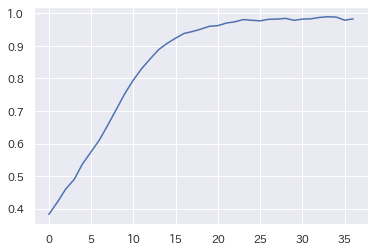

In [149]:
plt.plot(train_acc_history)

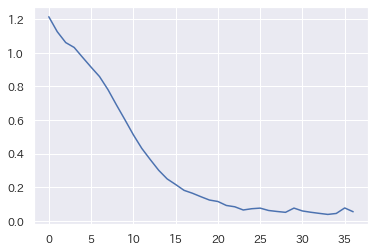

In [150]:
plt.plot(train_loss_history)

In [362]:
_ = tc.eval()

In [363]:
# テスト精度

corrects = 0

for batch in pb(test_dataloader):
    x = batch.text[0].to(DEVICE)
    y = batch.label.to(DEVICE)

    with torch.set_grad_enabled(False):

        pad_id = 1
        mask = (x != pad_id).to(DEVICE)

        out, w1, w2 = tc(x, mask)

        _, preds = torch.max(out, 1)

        corrects += torch.sum(preds == y.data)

test_acc = corrects.double() / len(test_dataloader.dataset)

In [364]:
test_acc

tensor(0.5703, device='cuda:0', dtype=torch.float64)

In [305]:
x = batch.text[0].to(DEVICE)
y = batch.label.to(DEVICE)

In [306]:
pad_id = 1
mask = (x != pad_id).to(DEVICE)

In [307]:
outs, w1, w2 = tc(x, mask)

In [358]:
def show_attention_batch(batch, outs, attn_weight1, attn_weight2):
    sentences = batch.text[0]
    labels = batch.label
    pred_probs = torch.softmax(outs, dim=1)
    pred_labels = torch.max(outs, 1)[1]
    #print(f'Prediction probability : {pred_probs}')
    print(f'Predicted Label : {pred_labels}, Correct Label : {labels}')

    down_mask = (pred_labels == 0).cpu().detach().numpy()
    no_change_mask = (pred_labels == 1).cpu().detach().numpy()
    up_mask = (pred_labels == 2).cpu().detach().numpy()

    up_pred_probs = pred_probs[up_mask][:, 2]
    down_pred_probs = pred_probs[down_mask][:, 0]

    up_pred_labels = labels[up_mask]
    down_pred_labels = labels[down_mask]

    attn1 = attn_weight1[:, 0, :].cpu().detach().numpy()
    attn1_up = np.array([b / b.max() for b in attn1[up_mask]])
    attn1_down = np.array([b / b.max() for b in attn1[down_mask]])
    attn1_no_change = np.array([b / b.max() for b in attn1[no_change_mask]])
    # attn1 /= attn1.max()

    attn2 = attn_weight2[:, 0, :]
    # attn2 /= attn2.max()

    up_sentence_mat = [[TEXT.vocab.itos[word_id] for word_id in sentence] for sentence in sentences[up_mask]]
    down_sentence_mat = [[TEXT.vocab.itos[word_id] for word_id in sentence] for sentence in sentences[down_mask]]
    no_change_sentence_mat = [[TEXT.vocab.itos[word_id] for word_id in sentence] for sentence in sentences[no_change_mask]]

    # up
    print('株価が上昇すると予測されたニューステキストAttentionMap')
    plt.figure(figsize=(260, 15))
    sns.heatmap(attn1_up, annot=np.asarray(up_sentence_mat), fmt='', cmap='Reds')
    plt.show()

    for p, s, correct_label in zip(up_pred_probs, up_sentence_mat, up_pred_labels):
        print(f'Correct Label={correct_label}, Predicted Label = 2, Confidence={p:.3f} : {s}')

    # down
    print('株価が下落すると予測されたニューステキストAttentionMap')
    plt.figure(figsize=(260, 15))
    sns.heatmap(attn1_down, annot=np.asarray(down_sentence_mat), fmt='', cmap='Blues')
    plt.show()

    for p, s, correct_label in zip(down_pred_probs, down_sentence_mat, down_pred_labels):
        print(f'Correct Label={correct_label}, Predicted Label = 0, Confidence={p:.3f} : {s}')

### 学習データの予測結果とアテンションマップ可視化

Predicted Label : tensor([2, 0, 2, 0, 2, 1, 2, 0, 2, 0, 2, 2, 2, 2, 1, 2, 0, 1, 0, 0, 2, 0, 1, 0,
        0, 2, 2, 2, 0, 1, 1, 2], device='cuda:0'), Correct Label : tensor([2, 0, 2, 0, 2, 1, 2, 0, 2, 0, 2, 2, 2, 2, 1, 2, 0, 1, 0, 0, 2, 0, 1, 0,
        0, 2, 2, 2, 0, 1, 1, 2])
株価が上昇すると予測されたニューステキストAttentionMap


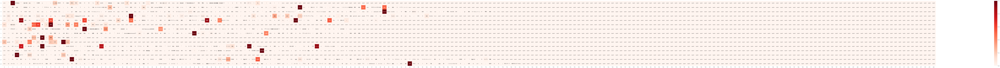

Correct Label=2, Predicted Label = 2, Confidence=1.000 : ['<cls>', '“', '1人', '10万円給付', '”', '補正予算', '成立', '「', '生活費', 'に', '…', '」', 'テレビ朝日', '市町村', 'の', '手続き', '本格化', '即日', '給付', 'の', '村', 'も', '一律', '10万円', '（', '時事通信', '）', '現金', '10万円', '一律', '給付', '迅速', 'な', '給付', 'へ', '総務省', 'が', '支援', '新型コロナ', 'nhk', 'news', 'web', '西目屋村', 'が', '特別定額給付金', 'の', '支給', '開始', 'by', '陸奥新報', '陸奥新報', '青森・西目屋村', 'で', '１', '０', '万', '円', '給付', 'スタート', '（', 'tbs', '系', '（', 'jnn', '）', '）', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '

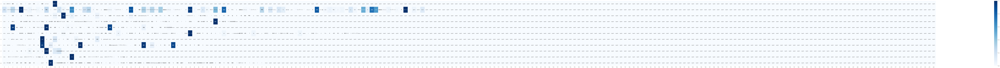

Correct Label=0, Predicted Label = 0, Confidence=0.995 : ['<cls>', '30年ぶり', '暴落', 'に', '映る', '「', 'コロナ', '恐慌', '」', '最悪', 'シナリオ', '（', '東洋経済オンライン', '）', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '

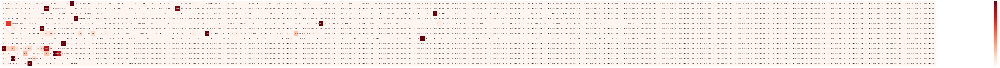

Correct Label=2, Predicted Label = 2, Confidence=1.000 : ['<cls>', 'au', '「', 'xperia', '1', 'ii', '」', 'を', '5月22日', '発売', '。', '219', '有機el', 'と', '20', 'fps', '連', '写', 'av', 'watch', '速報', '「', 'カメラグランプリ', '2020', '」', '大賞', 'と', 'レンズ', '賞', 'を', 'ソニー', 'α', 'が', '独占', '（', 'アスキー', '）', 'au', '、', 'xperia', '1', 'ii', 'を', '5月22日', '発売', '税込', '13', '万', '3600円', 'engadget', '日本版', 'au', 'の', '「', 'xperia', '1', 'ii', '」', 'は', '5月22日', '発売', '13', '万', '3600円', '（', '税込み', '）', 'itmedia', 'au', 'の', '「', 'xperia', '1', 'ii', '」', 'は', '5月22日', '発売', '13', '万', '3600円', '（', '税込み', '）', '（', 'itmedia', 'mobile', '）', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<

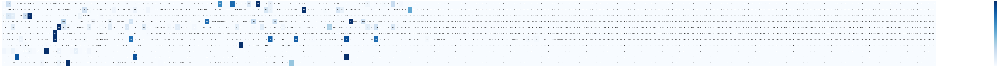

Correct Label=0, Predicted Label = 0, Confidence=0.989 : ['<cls>', 'ny円', '、', '3日', '続伸', '1ドル', '107円', '75', '～', '85', '銭', '米', '感染者数', '増', 'で', 'リスク回避', 'の', '円買い', '日本経済', '新聞', '〔', 'ロンドン', '外為', '〕', '円', '、', '108円', '近辺', '（', '31日', '）', '（', '時事通信', '）', 'ドル', 'は', '戻り', '売り', 'に', '押さ', 'れ', '、', 'ドル円', 'は', '１', '０', '７', '円', '台', '半ば', 'に', '下落', '＝', 'ｎｙ', '為替', '後半', 'みんな', 'の', '株式', 'ny', '為替', '：', '独', '経済', 'の', '深刻', 'な', 'リセッション', '織り込む', 'ユーロ', '売り', 'まぐまぐ', 'ニュース', '！', 'ny', 'マーケット', 'ダイジェスト', '・', '30日', '株高', '・', '金利上昇', '・', 'ユーロ', '安', '2020年', '03', '月', '31日', '（', '火', '）', '06', '時', '25分', '｜', 'fx', 'ニュース', 'ザイ', 'ｆｘ', '！', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<p

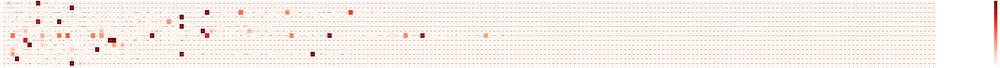

Correct Label=2, Predicted Label = 2, Confidence=0.991 : ['<cls>', '70代男性', 'が', '上野公園', '花見', 'で', '感染', 'か', '静岡県内', 'の', '感染者', 'は', '21人', 'に', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>

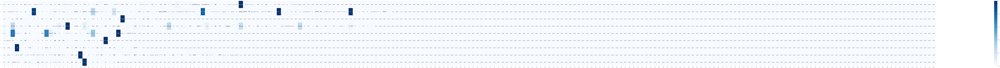

Correct Label=0, Predicted Label = 0, Confidence=1.000 : ['<cls>', '5日', '夜', 'から', '6日', '明け方', 'にかけ', '「', 'ストロベリームーン', '」', 'に', '今夜', 'は', '満月', '「', 'ストロベリームーン', '」', '今夜', 'の', '天気', 'は', '？', '明け方', '「', '半影月食', '」', 'も', 'ウェザーニュース', '今夜', '昇る', '月', 'は', '「', 'ストロベリームーン', '」', '天気', 'は', '日直', '予報', '士', '2020年', '06', '月', '05', '日', '日本気象協会', 'tenkijp', 'tenkijp', '寝屋川市内', 'で', '観測', 'さ', 'れ', 'た', 'ストリベリームーン', '2020', 'httpwwwneyagawanpjp', '【', 'ストロベリームーン', '】', '今夜', 'は', '満月', '、', '見', 'られる', 'エリア', 'は', '？', 'ウェザーニュース', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>',

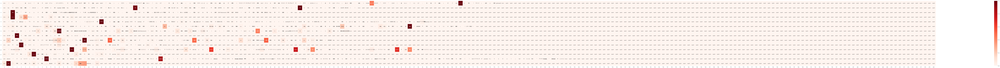

Correct Label=2, Predicted Label = 2, Confidence=1.000 : ['<cls>', '「', 'mtg', '」', '、', '新', 'カード', '「', '死', 'の', 'コロナ', 'ビーム', '、', 'スペースゴジラ', '」', 'の', '名称', '変更', 'および', '削除', 'を', '発表', 'game', 'watch', '「', 'mtg', '」', '×', 'ゴジラ', '。', '「', 'マジック：ザ・ギャザリング', '」', '最新', 'セット', '「', 'イコ', 'リア', '：', '巨', '獣', 'の', '棲処', '」', 'に', '映画', 'ゴジラ', 'シリーズ', 'に', '登場', 'する', '怪獣', '達', 'が', '参戦', 'へ', '「', 'マジック：ザ・ギャザリング', '」', 'ゴジラ', '参戦', 'コロナ', 'ビーム', 'は', '名称', '変更', '「', 'マジック・ザ・ギャザリング', '」', 'の', '「', 'ゴジラ', '」', 'コラボカード', 'に', '「', '死', 'の', 'コロナ', 'ビーム', '」', '追って', '削除', '・', '変更', 'へ', 'itmedia', 'ヘルスケア', 'まさかの', '“', 'ゴジラ', '”', 'コラボ', '！', '新', 'セット', '「', 'イコ', 'リア', '：', '巨', '獣', 'の', '棲処', '」', 'が', '『', 'mtg', 'アリーナ', '』', '含む', '「', 'マジック', '」', '世界', 'に', '登場', 'gamespark', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<

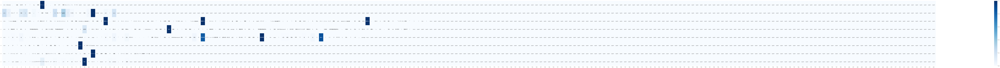

Correct Label=0, Predicted Label = 0, Confidence=1.000 : ['<cls>', 'linksmate', '、', '月額', '500円', 'の', '「', '5g', '回線', 'オプション', '」', '、', '9月', 'まで', '無料', 'キャンペーン', 'も', 'ケータイ', 'watch', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', 

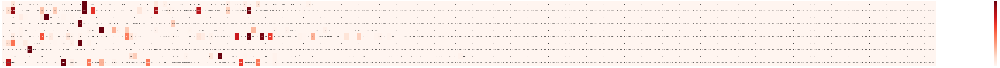

Correct Label=2, Predicted Label = 2, Confidence=0.998 : ['<cls>', '「', '若者', 'が', '感染拡大', '、', '密集', '地', '避け', 'て', '」', '専門家会議', 'が', '呼びかけ', '朝日新聞', '「', '症状', 'の', '軽', 'い人', 'が', '感染拡大', 'に', '重要', 'な', '役割', 'も', '」', '専門家会議', 'が', '10代', 'から', '30代', 'の', '全国', 'の', '若者', 'へ', 'お願い', '（', 'abematimes', '）', '専門家会議', 'で', '新', '見解', '軽症', '者', 'から', 'も', '拡大', 'wwwfnnjp', '北海道', '全体', 'に', '感染者', '拡大', '恐れ', 'auonejp', '「', '若者', 'が', '移動', 'し', '感染拡大', 'の', '可能性', '」', '専門家会議', 'が', '見解', '（', 'テレビ朝日', '系', '（', 'ann', '）', '）', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>'

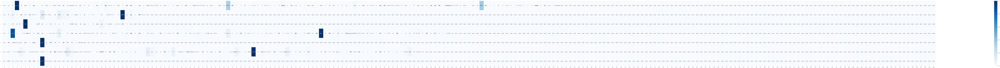

Correct Label=0, Predicted Label = 0, Confidence=1.000 : ['<cls>', 'ea', 'の', 'pcゲーム', 'が', 'steam', 'に', '追加', '、', 'ea', 'access', 'も', 'まもなく', 'steam', '対応', 'ign', 'japansteam', '再', '参入', 'の', 'ea', '，', '新た', 'に', '複数', 'タイトル', 'を', 'steam', 'で', '配信', '開始', '。', '今夏', 'に', 'は', 'サブスクリプションサービス', '「', 'ea', 'access', '」', 'も', 'steam', 'で', '提供', 'へ', 'ea', 'サブスクリプションサービス', '「', 'ea', 'access', '」', 'steam', '版', '間もなく', '開始', '！', '『', 'nfs', '』', 'シリーズ', 'や', '『', 'クライシス', '3', '』', 'の', '販売開始', 'や', '記念', 'セール', 'も', '（', 'game', 'spark', '）', 'steam', 'に', '再', '参入', 'し', 'た', 'ea', '、', '新た', 'に', '多数', 'の', 'タイトル', 'を', '配信', '開始', '。', 'サブスクリプションサービス', '「', 'ea', 'access', '」', 'の', 'steam', '版', 'も', '今夏', '提供', '開始', 'へ', 'automatonea', 'サブスクリプションサービス', '「', 'ea', 'access', '」', 'steam', '版', '間もなく', '開始', '！', '『', 'nfs', '』', 'シリーズ', 'や', '『', 'クライシス', '3', '』', 'の', '販売開始', 'や', '記念', 'セール', 'も', 'gamespark', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>

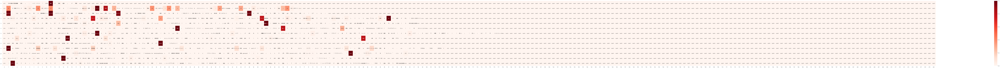

Correct Label=2, Predicted Label = 2, Confidence=0.997 : ['<cls>', '「', 'とある魔術の禁書目録', '幻想', '収束', '」', '，', 'レイド', 'イベント', '「', 'とある', '賢者', 'の', '魔術', '議論', '」', 'が', '開催', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>'

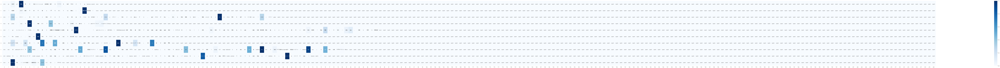

Correct Label=0, Predicted Label = 0, Confidence=0.999 : ['<cls>', 'jra', '大阪杯', 'g1', '昇格', '後', 'の', '怪', 'ステイフーリッシュ', 'と', '岩田康誠', '騎手', 'は', 'ジンクス', 'を', '払拭', 'できる', 'か', '？', 'gj', 'business', 'journal', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>'

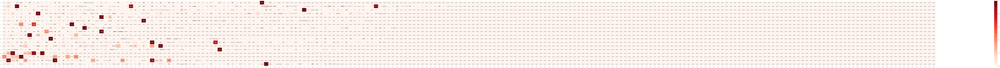

Correct Label=2, Predicted Label = 2, Confidence=1.000 : ['<cls>', 'nvidia', '、', '2倍', '高速化', 'で', '画質', 'も', '向上', 'し', 'た', 'ai', '処理', '技術', '「', 'dlss', '20', '」', 'を', '投入', 'impresscojpnvidia', 'が', '「', 'dlss', '20', '」', 'を', '発表', '。', 'ai', '活用', 'の', '高', '精細', '化', '技術', 'が', '画質', 'と', '描画', '性能', 'を', '大幅', 'に', '向上', 'する', 'dlss', '20', 'を', 'レビュー', '、', 'geforce', 'rtx', 'の', '価値', 'を', '爆上', 'げする', 'wqhd', '＆', '4k', '時代', 'の', '救世主', '14', 'asciijp', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pa

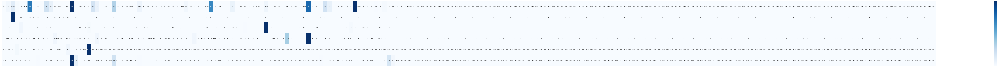

Correct Label=0, Predicted Label = 0, Confidence=1.000 : ['<cls>', 'ps4', 'switchpc', '用', '「', 'winning', 'post', '9', '2020', '」', '本日', '発売', 'game', 'watch', '「', 'winning', 'post', '9', '2020', '」', 'が', '本日', '発売', '。', '秘書', 'の', '追加', '衣装', 'や', '施設', '機能拡張', '，', '競走馬', 'など', 'dlc', 'も', '順次', '配信', '。', '加藤純一', 'さん', 'の', 'チャレンジ', '企画', '生放送', 'も', '決定', '「', 'winning', 'post', '9', '2020', '」', 'が', '発売', '！', '秘書', '衣装', 'や', '施設', '機能拡張', '、', '競走馬', 'など', '各種', 'dlc', 'が', '配信', '開始', 'gamer', '『', 'winning', 'post', '9', '2020', '』', '本日', '発売', '！', '子孫', '継承', 'システム', 'や', '絆', 'コマンド', 'の', '進化', 'が', '最高', 'の', '競馬', 'ゲーム', '体験', 'を', '実現', '！', 'playstation', 'com', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', 

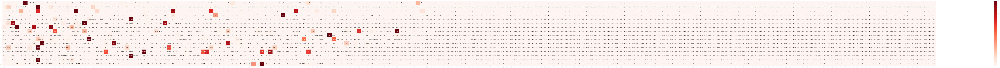

Correct Label=2, Predicted Label = 2, Confidence=1.000 : ['<cls>', 'vw', 'の', '世界', '最', '量販車', 'は', 'ティグアンゴルフ', 'を', '抜く', '2019年', 'レスポンス', '35秒', 'に', '1', '台', '製造', 'suv', 'の', 'ティグアン', 'が', '2019年', 'で', '1番', '売れ', 'た', 'vw', 'に', 'フォルクスワーゲン', '、', 'suv', '「', 'ティグアン', '」', '改良', 'を', '予告', '。', 'ハイライト', 'の', '1つ', 'は', 'phev', 'モデル', 'car', 'watch', 'vw', 'ポロ', 'サイズ', 'の', '新', 'suv', 'クーペ', '『', 'ニーヴァス', '』', '、', 'プロトタイプ', 'の', '画像', '…', '2020年', '内', 'に', '発表', '予定', 'レスポンス', 'vw', 'ティグアン', 'が', '生産', '累計', '600万', '台', 'を', '達成', '。', '売れ', 'て', 'いる', '55', 'は', '、', '日本', 'で', 'は', '買え', 'ない', '3', '列', 'シート', 'ロング', 'ホイールベース', '仕様', 'の', '「', 'ティグアン・オールスペース', '」', 'motorfan', 'モーターファン', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '

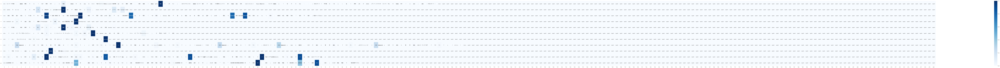

Correct Label=0, Predicted Label = 0, Confidence=0.999 : ['<cls>', 'センバツ', '甲子園', '、', '無観客', '開催', 'で', 'も', '「', 'なぜ', '野球', 'だけ', '」', 'と', '物議', '…', '高体連', 'の', '25', '大会', 'は', 'すべて', '中止', 'ビジネスジャーナル', 'business', 'journal', '尽誠学園', '6日', 'ぶり', '練習', '再開', '、', '西村', '監督', '「', '見極め', 'ながら', '進め', 'て', 'いき', 'たい', '」', '（', 'スポニチアネックス', '）', '無観客', 'センバツ', '強行', 'が', '球児', 'の', '精神的ショック', 'を', '招く', '可能性', '新田', '日明', '（', 'スポーツライター', '）', 'blogos', '伊達みきお', '、', 'センバツ', '無観客', 'に', '「', '何', 'だ', 'か', 'なぁ', '…', '…', '」', '日刊スポーツ', '「', '甲子園', 'は', '一生', 'に', '一', '度', '！', '野球', '人生', 'が', '決まる', '」', 'デーブ・スペクター', 'が', 'センバツ', '中止', 'の', '可能性', '受け', '「', '大', '反対', '」', '表明', '（', '中日スポーツ', '）', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>

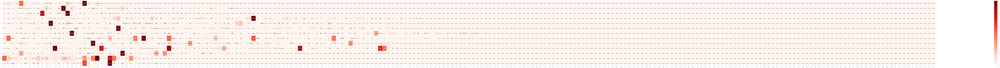

Correct Label=2, Predicted Label = 2, Confidence=1.000 : ['<cls>', 'iphone', '12', 'pro', 'max', '仮', '、', 'センサー', 'シフト', '式', '手ぶれ補正', '搭載', 'の', '噂', '。', '2022年', 'モデル', 'は', 'ペリスコープ', '望遠', '採用', 'か', 'engadget', '日本版', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<

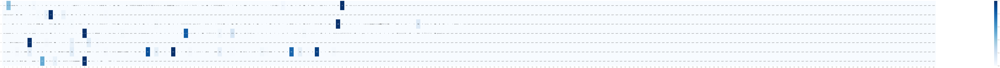

Correct Label=0, Predicted Label = 0, Confidence=1.000 : ['<cls>', 'vリーグ', '入れ替え戦', '中止', 'に', '「', '試合', 'すら', 'し', 'て', 'ない', 'の', 'に', '負け', 'た', '」', '（', '道新スポーツ', '）', '２', '部', 'チーム', 'の', '入れ替え戦', '中止', '→', '延期', '要望', '、', '退け', 'られる', '日刊スポーツ', '入れ替え戦', '中止', 'ヴォレアス', '無念', 'バレーボール', 'ｖ２', '男子', '北海道新聞', '動画', 'ニュース', '【', 'ｖリーグ', '】', 'ヴォレアス', '、', 'コロナ', '影響', 'で', 'まさかの', '入れ替え戦', '中止', 'に', '「', '夢', 'と', '可能性', 'を', 'つぶさ', 'ない', 'で', '」', '（', 'スポーツ報知', '）', 'バレー', 'の', '試合', 'で', 'なぜ', '蜂蜜', 'が', '売れる', '？', '北海道', 'チーム', 'の', 'データ', '活用', '術', '日経', 'クロス', 'トレンド', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>

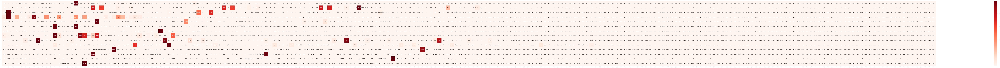

Correct Label=2, Predicted Label = 2, Confidence=1.000 : ['<cls>', '【', '↓', '】', '日経平均', '大引け', '｜', '続落', '、', '円高進行', 'や', '地政学', 'リスク', 'を', '警戒', 'し', '売り優勢', '6月18日', 'minkabu', 'pr', 'ess', '日経平均', 'は', '反発', '、', '30円', '高', '東', 'エレク', 'は', '大幅続伸', 'ロイター', 'reuters', 'japan', '日経平均', '100円', '安', '､', '簡単', 'に', 'は', '上昇', 'でき', 'ない', 'ワケ', '東洋経済オンライン', '日経平均', 'は', '続落', '、', '米', '株', '先物', 'にらみ', '軟調', '推移', '円高', 'も', '重荷', '（', 'ロイター', '）', '日経平均', 'は', '続落', '、', '米', '株', '先物', 'の', '軟化', 'と', '円高', 'を', '嫌気', 'ロイター', 'reuters', 'japan', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>',

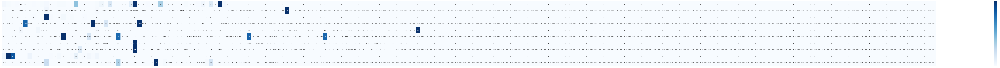

Correct Label=0, Predicted Label = 0, Confidence=0.993 : ['<cls>', '「', 'なんで', '、', '背負っ', 'ちゃっ', 'た', 'ん', 'だろ', 'う', '？', '」', 'あの日', '、', '伸ばさ', 'れ', 'た', '手', 'を', '掴め', 'なかっ', 'た', '「', '16歳', 'の', '語り部', '」', 'は', '考え', '続ける', '（', 'buzzfeed', 'japan', '）', '伸ばさ', 'れ', 'た', '手', '、', '掴め', 'なかっ', 'た', '。', 'だから', '語り', '続ける', '「', '16歳', 'の', '語り部', '」', 'buzzfeed', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pa

In [365]:
n_batch_show = 10
i = 0

for batch in train_dataloader:
    x = batch.text[0].to(DEVICE)
    y = batch.label.to(DEVICE)
    pad_id = 1
    mask = (x != pad_id).to(DEVICE)
    outs, w1, w2 = tc(x, mask)
    show_attention_batch(batch=batch, outs=outs, attn_weight1=w1, attn_weight2=w2)
    i += 1
    if i == n_batch_show:
        break
    print('='*60)

### テストデータの予測結果とアテンションマップ可視化

Predicted Label : tensor([2, 2, 1, 2, 0, 1, 0, 1, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 1, 1, 2, 2, 0, 1,
        2, 0, 2, 1, 1, 2, 1, 2], device='cuda:0'), Correct Label : tensor([2, 2, 1, 2, 2, 1, 0, 0, 0, 1, 2, 1, 0, 2, 2, 2, 2, 1, 1, 1, 1, 2, 0, 2,
        2, 2, 0, 1, 1, 2, 1, 2])
株価が上昇すると予測されたニューステキストAttentionMap


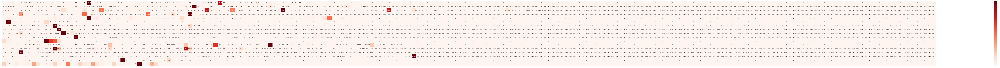

Correct Label=2, Predicted Label = 2, Confidence=1.000 : ['<cls>', 'iphone', 'や', 'mac', 'で', '使える', 'ワイヤレス', 'ゲームコントローラー', '、', 'steelseries', 'から', '<unk>', '、', 'iphone', 'や', 'mac', 'に', '対応', 'し', 'た', 'ワイヤレスゲーミングコントローラー', '“', 'nimbus', 'wireless', 'controller', '”', 'を', '発表', 'ファミ通', 'com', 'steelseries', '，', 'iphone', 'や', 'mac', '対応', 'の', 'bluetooth', 'ゲームパッド', '「', 'nimbus', '＋', '」', 'を', '発表', 'steelseries', '、', 'apple', 'デバイス', '対応', 'の', 'ワイヤレスゲーミングコントローラー', '発売', 'game', 'watch', 'iphone', '認証', '済', 'コントローラ', 'に', '新モデル', '。', '「', 'steelseries', 'nimbus', '」', 'が', 'apple', 'ストア', 'で', '発売', 'engadget', '日本版', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '

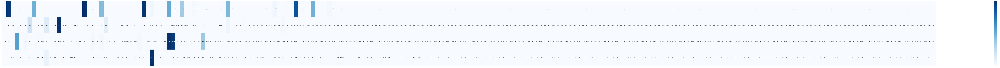

Correct Label=2, Predicted Label = 0, Confidence=0.556 : ['<cls>', 'yoshiki', '、', '『', '国立国際医療研究センター', '』', 'に', '1000万円', '寄付', '「', '少し', 'でも', '力', 'に', 'なれ', 'ば', '」', 'oricon', 'news', 'yoshiki', '、', '国立国際医療研究センター', 'に', '1000万円', '寄付', '（', 'コメント', 'あり', '）', 'ナタリー', 'x', 'japan', '・', 'yoshiki', '、', '医療従事者', '支援', 'の', 'ため', '1000万円', '寄付', '新型コロナ', 'ウイルス感染', '拡大', 'による', '日本の医療', '崩壊', 'を', '憂慮', 'auonejpyoshiki', 'が', '国立国際医療研究センター', 'へ', '1000万円', 'を', '寄付', '「', '少し', 'でも', '力', 'に', 'なれ', 'ば', '」', '医療従事者', 'の', 'サポート', 'へ', '中日スポーツ', 'yoshiki', '、', '国立国際医療研究センター', 'に', '1000万円', 'を', '寄付', '（', 'barks', '）', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>'

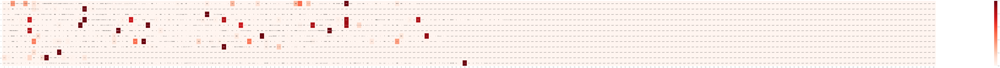

Correct Label=2, Predicted Label = 2, Confidence=1.000 : ['<cls>', '注目', 'トピックス', '日本株', 'レナウン', 'ストップ安売り気配', '、', 'コロナ', '痛手', 'で', '民事再生手続き', '開始', '2020年', '5月18日', 'エキサイトニュース', 'エキサイトニュース', 'レナウン', 'が', '民事再生', '、', '今', '年初', 'の', '上場企業', '倒産', 'ダイヤモンド', '・', 'チェーンストア', '・', 'オンライン', 'アパレル', '大手', '「', 'レナウン', '」', '破綻', 'で', '…', '次', 'の', '“', '大型', '倒産', '企業', '”', 'は', 'どこ', 'だ', '識者', '「', 'ここ', '２', '、', '３', 'カ月', 'が', 'カギ', '。', '<unk>', 'や', '年末', 'が', '倒産', 'の', 'ピーク', 'に', '」', 'zakzak', 'アパレル', '激震', '上', '「', 'トップ', '不在', '」', 'レナウン', '<unk>', 'の', '末路', '日本経済', '新聞', '西村', '担当相', '、', 'レナウン', '破綻', 'に', '「', '残念', 'だ', '。', '全て', 'の', '事業者', '継続', 'に', '全力', '」', 'auonejp', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '

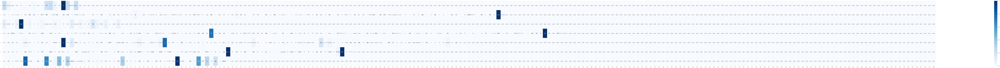

Correct Label=1, Predicted Label = 0, Confidence=0.925 : ['<cls>', 'samsung', 'galaxy', 'note', '20', '：', '<unk>', 'は', 'カメラ', 'の', '仕様', 'に', 'なり', 'ます', 'か', '？', 'mobilanyheter', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>'

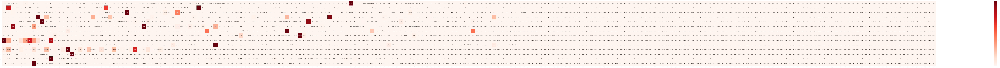

Correct Label=1, Predicted Label = 2, Confidence=1.000 : ['<cls>', '「', 'かぐや様は告らせたい', '？', '」', '声優', '・', '<unk>', '、', '“', 'すごろく', '回', '”', 'の', '<unk>', 'は', 'アドリブ', 'アニメ', '！', 'アニメ', '！', 'anime', 'anime', '<unk>', '顔', 'や', 'それ', 'な！', '顔', 'が', '付属', '！', '『', 'かぐや様は告らせたい', '』', 'ねんどろいど', '白銀御行', 'フィギュア', 'が', 'amazon', 'で', '予約', '受付中', '！', '電撃', 'ホビーウェブ', '春', 'アニメ', '『', 'かぐや様は告らせたい', '？～', '天才たちの恋愛頭脳戦', '～』', '<unk>', '役', '：', '<unk>', 'さん', '＆', '<unk>', '役', '：', '<unk>', 'さん', 'メール', 'インタビュー', 'お', 'ふたり', 'が', '第', '2期', 'で', '一番', '笑い', 'を', '<unk>', 'の', 'に', '必死', 'に', 'なっ', 'た', 'シーン', 'と', 'は', '？', 'アニメイトタイムズ', '天真爛漫', 'な', '彼女', 'らしい', '笑顔', 'が', '眩しい', '！', '『', 'かぐや様は告らせたい', '』', '藤原千花', 'が', 'バニー', '姿', 'で', '<unk>', 'から', 'フィギュア', '化', '！', '電撃', 'ホビーウェブ', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>

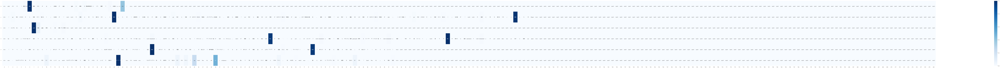

Correct Label=2, Predicted Label = 0, Confidence=1.000 : ['<cls>', '26日', 'ぶり', 'の', '「', '新型コロナ', '陽性', '確認', 'ゼロ', 'の', '日', '」', '北海道', 'が', '発表', '…', '延長', 'か', '解除', 'か', '緊急事態宣言', 'に', 'どう', '影響', '？', '（', '北海道', 'ニュース', 'uhb', '）', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<p

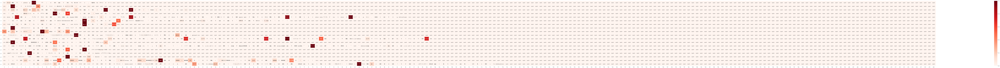

Correct Label=0, Predicted Label = 2, Confidence=0.997 : ['<cls>', '4月25日', '開催', 'の', '「', 'pokémon', 'go', 'コミュニティ', '・', 'デイ', '」', 'は', '形式', '変更', 'で', '自宅', 'でも', '楽しめる', 'よう', 'に', '。', '大量発生', 'する', 'ポケモン', 'は', 'ケーシィ', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>'

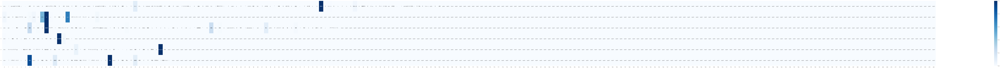

Correct Label=0, Predicted Label = 0, Confidence=1.000 : ['<cls>', '「', 'あつまれ', 'どうぶつの森', '」', '、', '世界', 'の', '<unk>', 'や', '企業', 'マイデザイン', '作品', 'を', '一挙', 'まとめ', 'て', '紹介', '！', 'game', 'watch', '『', 'あつまれ', 'どうぶつの森', '』', 'の', 'テーマ曲', 'を', '演奏', 'し', 'て', 'もらい', 'まし', 'た', 'nintendo', '公式', 'チャンネル', '世界中', 'の', '企業', 'が', '<unk>', '『', 'どうぶつの森', '』', 'に', '期待', 'を', 'かける', 'ワケ', '（', '現代ビジネス', '）', '『', '<unk>', '』', 'で', '“', 'いまさら', '聞け', 'ない', '『', 'あつ森', '』', '”', '特集', 'を', '5月17日', 'に', '放送', '。', '『', 'あつ森', '』', 'や', '攻略本', 'の', 'ツイート', 'を', 'し', 'て', 'い', 'た', '松本人志', 'や', '指原莉乃', 'が', 'ゲーム', 'を', 'プレイ', 'ファミ通', 'com', '任天堂', '、', '「', 'あつまれ', 'どうぶつの森', '」', 'テーマ曲', 'の', 'リモート', '<unk>', 'を', '公開', 'game', 'watch', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '

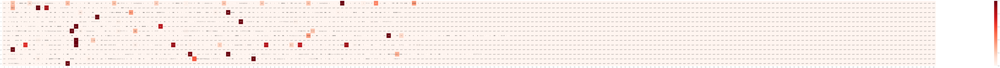

Correct Label=2, Predicted Label = 2, Confidence=1.000 : ['<cls>', 'ps', 'now', 'に', '期間限定', '新規', '追加', 'タイトル', 'として', '「', 'marvels', 'spiderman', '」', 'や', '「', 'just', 'cause', '4', '」', 'が', '登場', '！', 'gamer', '4月', 'の', 'ps', 'now', '新規', 'タイトル', 'に', '『', 'marvels', 'spiderman', '』', 'や', '『', 'just', 'cause', '4', '』', 'など', '期間限定', '含め', '3', 'タイトル', 'が', '登場', '！', 'playstation', 'com', '「', 'ps', 'now', '」', '、', '「', 'marvels', 'spiderman', '」', 'や', '「', 'just', 'cause', '4', '」', 'を', '期間限定', 'で', '配信', 'game', 'watch', 'ps', 'now', 'に', '『', 'marvels', 'spiderman', '』', '、', '『', 'ジャストコーズ', '4', '』', 'など', '全', '3', 'タイトル', 'が', '新た', 'に', '登場', '。', '7日間', '体験', 'できる', '利用権', 'の', '販売期間', 'も', '延長', 'ファミ通', 'com', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>'

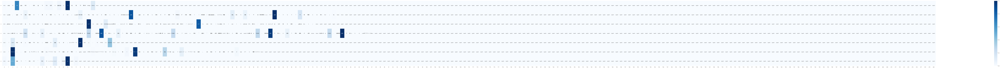

Correct Label=0, Predicted Label = 0, Confidence=1.000 : ['<cls>', '99歳', 'の', '英', '退役', '大尉', '、', '自宅', '庭', 'を', '100', '往復', 'で', '医療支援', 'に', '十', '数', '億', '円', '集める', 'wedge', 'infinity', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<p

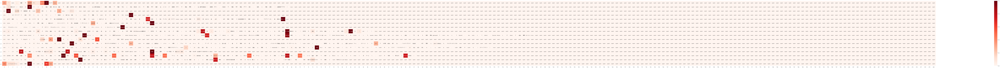

Correct Label=2, Predicted Label = 2, Confidence=0.987 : ['<cls>', '「', '<unk>', '」', '秘書', 'の', '増田紗織', 'アナ', '、', '体調不良', 'か', '日刊スポーツ', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>

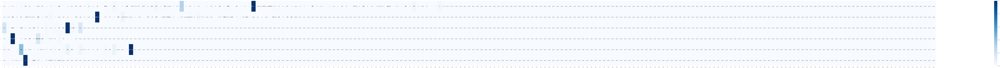

Correct Label=0, Predicted Label = 0, Confidence=0.997 : ['<cls>', '「', 'エール', '」', '“', '三郎', 'ロス', '”', '広がる', '浩二', 'へ', 'の', '“', '遺言', '”', 'に', 'ネット', '号泣', '58年', 'の', '人生', 'に', '幕', '“', '最終回', '？', '演出', '”', 'も', '話題', '（', 'スポニチアネックス', '）', '朝ドラ', 'op', '流れず', '演出', 'に', '称賛', 'auonejp', '＜', 'エール', '＞', '『', '生き', 'て', 'くれ', '…', '』', '父子', 'の', '会話', 'に', '視聴者', '、', '号泣', '（', '12', '）', '芸能ニュース', 'なら', 'ザテレビジョン', 'ザテレビジョン', '唐沢寿明', 'から', '2人', 'の', '息子', 'に', '<unk>', 'れ', 'た', '“', '最後', 'の', 'エール', '”', '『', 'エール', '』', '浩二', '役', '・', '佐久本宝', 'の', '笑顔', 'に', '涙', '（', 'リアルサウンド', '）', '窪田正孝', '「', 'エール', '」', '深刻', 'な', '病状', 'の', '三郎', '20', '・', '７', '％', 'ニッカン', 'スポーツ', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<p

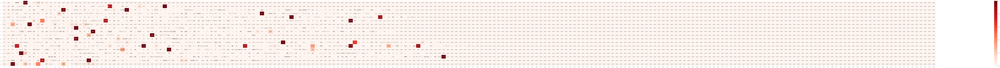

Correct Label=2, Predicted Label = 2, Confidence=0.999 : ['<cls>', 'glay', '、', '医療機関', 'に', '1000万円', '＋', 'マスク', '5000枚', '寄付', 'oricon', 'news', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>

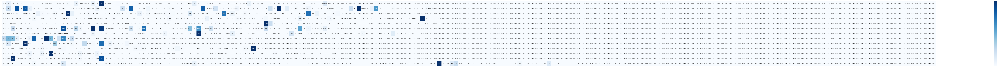

Correct Label=1, Predicted Label = 0, Confidence=0.807 : ['<cls>', 'ps4', 'xbox', 'one', 'pc', '「', 'fifa', '21', '」', 'が', '2020年', '<unk>', 'に', '発売決定', '！', 'ps5', '版', 'へ', 'の', '無償アップグレード', 'に', '対応', 'g', 'am', 'er', 'playstation', '5', 'と', 'xbox', 'series', 'x', 'で', '次世代', 'の', 'スポーツ', 'を', '体験', 'できる', '「', 'fifa', '21', '」', 'と', '「', 'madden', 'nfl', '21', '」', 'の', 'トレイラー', 'が', '公開', '『', 'fifa', '21', '』', 'の', '次世代機', 'へ', 'の', '移行', '施策', 'が', '発表', '現', '世代', '機', '版', 'を', '買え', 'ば', '無料', 'で', '次世代機', '版', 'に', 'アップグレード', 'できる', 'ign', 'japan', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>

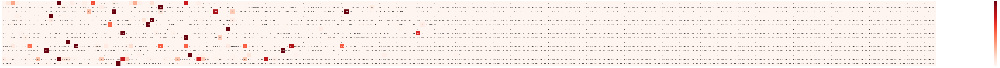

Correct Label=2, Predicted Label = 2, Confidence=1.000 : ['<cls>', 'pixel', 'buds', '（', '2020', '）', 'レビュー', '：', 'つけ', '心地', 'や', '音', 'は', 'いい', 'けど', '、', 'ちょっと', '問題', 'も', '（', '2020年', '5月12日', '）', '｜', 'google', 'の', '完全', 'ワイヤレス', 'イヤホン', '｢', 'pixel', 'buds', '（', '2020', '）', '｣', 'レビュー', '：', 'つけ', '心地', 'や', '音', 'は', 'いい', 'けど', '、', 'ちょっと', '問題', 'も', 'gizmodo', 'japan', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>'

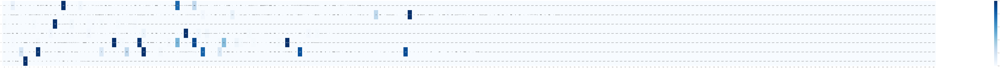

Correct Label=2, Predicted Label = 0, Confidence=1.000 : ['<cls>', '「', '私たち', 'も', '困っ', 'て', 'いる', '」', '国内', '女子ツアー', '開幕', '発表', 'も', '小林', '会長', 'が', '本音', '（', 'no', '<unk>', '）', 'ツアー', 'ニュース', 'ゴルフ', '情報', 'albanet', '「', 'やり', 'たい', '思い', 'は', '首尾', '一貫', '」', '女子ゴルフ', '“', '開幕戦', '”', '決意', 'に', 'アース製薬', '会長', 'ゴルフダイジェスト・オンライン', '【', '木村和久', '連載', '】', 'コロナショック', '後', '。', 'ゴルフ界', 'の', '「', '出口戦略', '」', 'を', '探る', '（', 'web', 'スポルティーバ', '）', '畑岡奈紗', '日本ツアー', '開幕戦', '出場', 'へ', '25日', 'から', 'の', 'アースモンダミン', '杯', 'スポニチアネックス', 'sponichi', 'annex', '女子ゴルフ', '、', '畑岡', 'が', '今季初戦', 'へ', '日本ツアー', '、', 'アースモンダミン', '杯', '中日新聞', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<p

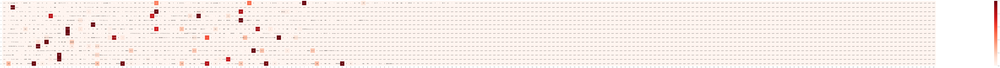

Correct Label=2, Predicted Label = 2, Confidence=1.000 : ['<cls>', 'nhk', '近江友里恵', 'アナ', '“', '駆け落ち', '婚', '”', '<unk>', 'の', '夫', '、', '後輩', '女性', 'ディレクター', 'と', 'の', '不倫', 'を', '否定', 'ニフティ', 'ニュース', 'nhk', '「', '近江友里恵', 'アナ', '」', 'の', '年上', '夫', 'に', '囁か', 'れる', '女性', 'の', 'ウワサ', '本人', 'は', '“', '不倫', 'で', 'は', 'ありません', '”', '（', 'デイリー', '新潮', '）', 'yahoo', 'nhk', '近江友里恵', 'アナ', 'の', '夫', 'に', '女性', 'の', '噂', '本人', 'は', '「', '不倫', 'で', 'は', 'ありません', '」', 'nhk', '近江', 'アナ', '、', '結婚', 'スルー', 'で', '『', 'あさイチ', '』', '危機', '！', '「', '<unk>', '＆', '華大', '」', '消し', '日刊', '大衆', 'ｎｈｋ', '「', 'あさイチ', '」', 'の', '性', '生活', '特集', '再開', 'は', '日常生活', 'が', '戻り', 'つつ', 'ある', '<unk>', 'か', '（', '東スポ', 'web', '）', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pa

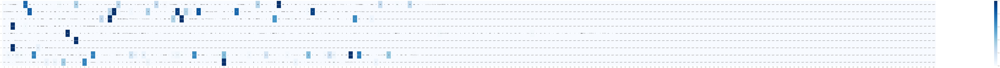

Correct Label=0, Predicted Label = 0, Confidence=0.999 : ['<cls>', '「', 'マスク在庫速報', '」', '、', 'アルコール', '消毒', '液', 'に', 'も', '対応', 'し', '、', 'サービス', '名', 'を', '「', '在庫', '速報', 'com', '」', 'に', '変更', 'pr', 'times', 'ecサイト', 'から', '在庫', 'ある', 'マスク', '集め', 'た', 'webサイト', '消毒', '液', 'の', '在庫', 'も', '追加', '「', 'マスク在庫速報', '」', 'に', '消毒液', 'も', '追加', '、', '新型コロナ', '対策', 'に', '強い', '味方', '（', 'bcn', '）', '「', 'マスク在庫速報', '」', 'が', '「', '在庫', '速報', 'com', '」', 'に', 'アルコール', '消毒', '液', 'の', '検索', 'に', 'も', '対応', 'itmedia', 'ローンチ', 'から', '1週間', 'で', '100万人', 'が', 'アクセス', 'し', 'た', '「', 'マスク在庫速報', '」', '、', '消毒液', 'の', '在庫', 'と', '価格', 'を', '追加', 'し', '「', '在庫', '速報', 'com', '」', 'として', 'リニューアル', 'the', 'bridgeinc', '株式会社', 'the', 'bridge', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<p

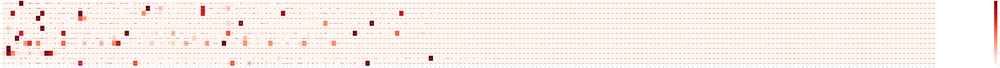

Correct Label=0, Predicted Label = 2, Confidence=0.990 : ['<cls>', 'クルーズ船', '下船', '岡山', '16人', 'は', '陰性', '新型コロナウイルス', '再検査', '（', '山陽新聞', 'デジタル', '）', '福岡県', 'の', 'クルーズ', '下船', '者', '全員', '陰性', '2週間', 'の', '観察', '期間', '終了', '西日本新聞', '沖縄', '・', '新型コロナ', '検査', '、', '9人', '全員', '陰性', '沖縄', 'タイムス', 'コロナ', 'で', '死者', 'が', '出', 'た', 'サンフランシスコ', '沖の', 'クルーズ船', 'に', '、', '検査キット', 'を', '落とす', '<unk>', '（', 'ギズモード・ジャパン', '）', 'コロナ', 'で', '死者', 'が', '出', 'た', 'サンフランシスコ', '沖の', 'クルーズ船', 'に', '、', '検査キット', 'を', '落とす', '<unk>', 'gizmodo', 'japan', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', 

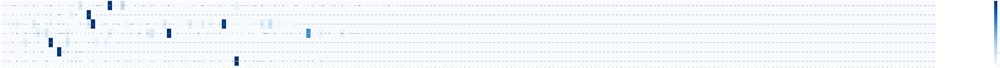

Correct Label=0, Predicted Label = 0, Confidence=1.000 : ['<cls>', '「', 'ハケンの品格', '」', 'は', '13年ぶり', 'の', '復活', 'で', 'も', 'なぜ', '視聴者', 'に', 'ウケる', 'の', 'か', 'goonejp', '“', '71歳', '”', '元', 'フジ', '敏腕', 'プロデューサー', '、', '他局', 'ドラマ', 'で', '俳優', 'デビュー', '「', '気軽', 'な', '気持ち', 'で', '引き受け', 'た', 'の', 'が', '間違い', 'でし', 'た', '…', '」', '（', 'オリコン', '）', '篠原涼子', 'の', 'チャーミング', 'な', '魅力', 'たっぷり', '！', '面白', 'シーン', 'まとめ', 'シネマトゥデイ', '『', 'ハケンの品格', '』', '続編', 'に', 'ファン', '歓喜', 'も', '展開', 'に', '「', '時代錯誤', '」', 'の', '声', 'auonejp', '「', 'ハケンの品格', '」', 'は', '13年ぶり', 'の', '復活', 'で', 'も', 'なぜ', '視聴者', 'に', 'ウケる', 'の', 'か', '（', 'デイリー', '新潮', '）', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<

In [366]:
n_batch_show = 10
i = 0

for batch in test_dataloader:
    x = batch.text[0].to(DEVICE)
    y = batch.label.to(DEVICE)
    pad_id = 1
    mask = (x != pad_id).to(DEVICE)
    outs, w1, w2 = tc(x, mask)
    show_attention_batch(batch=batch, outs=outs, attn_weight1=w1, attn_weight2=w2)
    i += 1
    if i == n_batch_show:
        break
    print('='*60)